In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV 
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.feature_selection import SelectKBest
from sklearn.preprocessing import RobustScaler, MinMaxScaler
from sklearn.feature_selection import f_classif
from sklearn.linear_model import Perceptron
from sklearn.metrics import accuracy_score, f1_score, recall_score, balanced_accuracy_score, precision_score, roc_curve, precision_recall_curve, matthews_corrcoef, auc
from sklearn.calibration import CalibratedClassifierCV
from scipy.stats import randint 
from imblearn.over_sampling import SMOTE
from collections import Counter
from xgboost import XGBClassifier
import shap

## Data Cleaning

In [3]:
df = pd.read_csv("heart_2022_no_nans.csv")

In [4]:
df.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,Alabama,Female,Very good,4.0,0.0,Within past year (anytime less than 12 months ...,Yes,9.0,None of them,No,...,1.60,71.67,27.99,No,No,Yes,Yes,"Yes, received Tdap",No,No
1,Alabama,Male,Very good,0.0,0.0,Within past year (anytime less than 12 months ...,Yes,6.0,None of them,No,...,1.78,95.25,30.13,No,No,Yes,Yes,"Yes, received tetanus shot but not sure what type",No,No
2,Alabama,Male,Very good,0.0,0.0,Within past year (anytime less than 12 months ...,No,8.0,"6 or more, but not all",No,...,1.85,108.86,31.66,Yes,No,No,Yes,"No, did not receive any tetanus shot in the pa...",No,Yes
3,Alabama,Female,Fair,5.0,0.0,Within past year (anytime less than 12 months ...,Yes,9.0,None of them,No,...,1.70,90.72,31.32,No,No,Yes,Yes,"No, did not receive any tetanus shot in the pa...",No,Yes
4,Alabama,Female,Good,3.0,15.0,Within past year (anytime less than 12 months ...,Yes,5.0,1 to 5,No,...,1.55,79.38,33.07,No,No,Yes,Yes,"No, did not receive any tetanus shot in the pa...",No,No


In [5]:
df.columns

Index(['State', 'Sex', 'GeneralHealth', 'PhysicalHealthDays',
       'MentalHealthDays', 'LastCheckupTime', 'PhysicalActivities',
       'SleepHours', 'RemovedTeeth', 'HadHeartAttack', 'HadAngina',
       'HadStroke', 'HadAsthma', 'HadSkinCancer', 'HadCOPD',
       'HadDepressiveDisorder', 'HadKidneyDisease', 'HadArthritis',
       'HadDiabetes', 'DeafOrHardOfHearing', 'BlindOrVisionDifficulty',
       'DifficultyConcentrating', 'DifficultyWalking',
       'DifficultyDressingBathing', 'DifficultyErrands', 'SmokerStatus',
       'ECigaretteUsage', 'ChestScan', 'RaceEthnicityCategory', 'AgeCategory',
       'HeightInMeters', 'WeightInKilograms', 'BMI', 'AlcoholDrinkers',
       'HIVTesting', 'FluVaxLast12', 'PneumoVaxEver', 'TetanusLast10Tdap',
       'HighRiskLastYear', 'CovidPos'],
      dtype='object')

In [6]:
STATES = {
   "Alabama" : 1 ,
   "Alaska" : 2,
   "Arizona" : 3,
   "Arkansas" : 4,
   "California" : 5,
   "Colorado" : 6,
   "Connecticut" : 7,
   "Delaware" : 8,
   "District of Columbia" : 9,
    "Florida" : 10,
    "Georgia" : 11,
    "Hawaii" : 12,
    "Idaho" : 13,
    "Illinois" : 14,
    "Indiana" : 15,
    "Iowa" : 16,
    "Kansas" : 17,
    "Kentucky" : 18,
    "Louisiana" : 19,
    "Maine" : 20,
    "Maryland" : 21,
    "Massachusetts" : 22,
    "Michigan" : 23,
    "Minnesota" : 24,
    "Mississippi" : 25,
    "Missouri" : 26,
    "Montana" : 27,
    "Nebraska" : 28,
    "Nevada" : 29,
    "New Hampshire" : 30,
    "New Jersey" : 31,
    "New Mexico" : 32,
    "New York" : 33,
    "North Carolina" : 34,
    "North Dakota" : 35,
    "Ohio" : 36,
    "Oklahoma" : 37,
    "Oregon" : 38,
    "Pennsylvania" : 39,
    "Rhode Island" : 40,
    "South Carolina" : 41,
    "South Dakota" : 42,
    "Tennessee" : 43,
    "Texas" : 44,
    "Utah" : 45,
    "Vermont" : 46,
    "Virginia" : 47,
    "Washington" : 48,
    "West Virginia" : 49,
    "Wisconsin" : 50,
    "Wyoming" : 51,
    "Guam" : 52,
    "Puerto Rico" : 53,
    "Virgin Islands" : 54,
}
df_copy = df.copy()
for i  in range(len(df["State"])):
       if df_copy["State"][i] in STATES:
           df_copy["State"][i] = STATES[df_copy["State"][i]]

heart_df = df_copy;


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

In [7]:
heart_df.head(250000)

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,Female,Very good,4.0,0.0,Within past year (anytime less than 12 months ...,Yes,9.0,None of them,No,...,1.60,71.67,27.99,No,No,Yes,Yes,"Yes, received Tdap",No,No
1,1,Male,Very good,0.0,0.0,Within past year (anytime less than 12 months ...,Yes,6.0,None of them,No,...,1.78,95.25,30.13,No,No,Yes,Yes,"Yes, received tetanus shot but not sure what type",No,No
2,1,Male,Very good,0.0,0.0,Within past year (anytime less than 12 months ...,No,8.0,"6 or more, but not all",No,...,1.85,108.86,31.66,Yes,No,No,Yes,"No, did not receive any tetanus shot in the pa...",No,Yes
3,1,Female,Fair,5.0,0.0,Within past year (anytime less than 12 months ...,Yes,9.0,None of them,No,...,1.70,90.72,31.32,No,No,Yes,Yes,"No, did not receive any tetanus shot in the pa...",No,Yes
4,1,Female,Good,3.0,15.0,Within past year (anytime less than 12 months ...,Yes,5.0,1 to 5,No,...,1.55,79.38,33.07,No,No,Yes,Yes,"No, did not receive any tetanus shot in the pa...",No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
246017,54,Male,Very good,0.0,0.0,Within past 2 years (1 year but less than 2 ye...,Yes,6.0,None of them,No,...,1.78,102.06,32.28,Yes,No,No,No,"Yes, received tetanus shot but not sure what type",No,No
246018,54,Female,Fair,0.0,7.0,Within past year (anytime less than 12 months ...,Yes,7.0,None of them,No,...,1.93,90.72,24.34,No,No,No,No,"No, did not receive any tetanus shot in the pa...",No,Yes
246019,54,Male,Good,0.0,15.0,Within past year (anytime less than 12 months ...,Yes,7.0,1 to 5,No,...,1.68,83.91,29.86,Yes,Yes,Yes,Yes,"Yes, received tetanus shot but not sure what type",No,Yes
246020,54,Female,Excellent,2.0,2.0,Within past year (anytime less than 12 months ...,Yes,7.0,None of them,No,...,1.70,83.01,28.66,No,Yes,Yes,No,"Yes, received tetanus shot but not sure what type",No,No


In [8]:
df_copy = heart_df.copy()
SEX = {
    'Male':1,
    'Female':2
}

GEN_HEALTH = {
    "Excellent":1,
    "Very good":2,
    "Good":3, 
    "Fair":4,
    "Poor":5
}

LAST_CHECKUP = {
    "Within past year (anytime less than 12 months ago)":1,
    "Within past 2 years (1 year but less than 2 years ago)":2,
    "Within past 5 years (2 years but less than 5 years ago)":3, 
    "5 or more years ago":4 
}
TEETH_REMOVED = {
    "1 to 5":1,
    "6 or more, but not all":2,
    "All":3,
    "None of them":4
}

DIABETES = {
    "Yes":1,
    "Yes, but only during pregnancy (female)":2,
    "No":3,
    "No, pre-diabetes or borderline diabetes":4
}

SMOKER_STATUS = {
    "Current smoker - now smokes every day":1, 
    "Current smoker - now smokes some days":2, 
    "Former smoker":3, 
    "Never smoked":4
}

ECIGARETTES = {
    "Never used e-cigarettes in my entire life":1,
    "Use them every day":2,
    "Use them some days":3,
    "Not at all (right now)":4
}

RACE = {
    "White only, Non-Hispanic":1,
    "Black only, Non-Hispanic":2,
    "Other race only, Non-Hispanic":3,
    "Multiracial, Non-Hispanic":4,
    "Hispanic":5,
}

AGE_CATEGORY = {
   "Age 18 to 24":1,
   "Age 25 to 29":2,
   "Age 30 to 34":3,
   "Age 35 to 39":4,
   "Age 40 to 44":5,
   "Age 45 to 49":6,
   "Age 50 to 54":7,
   "Age 55 to 59":8,
   "Age 60 to 64":9,
    "Age 65 to 69":10,
    "Age 70 to 74":11,
    "Age 75 to 79":12,
    "Age 80 or older":13
}

TETANUS = {
    "Yes, received Tdap":1,
    "Yes, received tetanus shot, but not Tdap":2,
    "Yes, received tetanus shot but not sure what type":3,
    "No, did not receive any tetanus shot in the past 10 years":4
}

COVID = {
    "Yes":1,
    "No":2,
    "Tested positive using home test without a health professional":3
}

for i  in range(len(df["State"])):
    df_copy["Sex"][i] = SEX[df_copy["Sex"][i]]
    df_copy["GeneralHealth"][i] = GEN_HEALTH[df_copy["GeneralHealth"][i]]
    df_copy["LastCheckupTime"][i] = LAST_CHECKUP[df_copy["LastCheckupTime"][i]]
    df_copy["RemovedTeeth"][i] = TEETH_REMOVED[df_copy["RemovedTeeth"][i]]
    df_copy["HadDiabetes"][i] = DIABETES[df_copy["HadDiabetes"][i]]
    df_copy["SmokerStatus"][i] = SMOKER_STATUS[df_copy["SmokerStatus"][i]]
    df_copy["ECigaretteUsage"][i] = ECIGARETTES[df_copy["ECigaretteUsage"][i]]
    df_copy["RaceEthnicityCategory"][i] = RACE[df_copy["RaceEthnicityCategory"][i]]
    df_copy["AgeCategory"][i] = AGE_CATEGORY[df_copy["AgeCategory"][i]]
    df_copy["TetanusLast10Tdap"][i] = TETANUS[df_copy["TetanusLast10Tdap"][i]]
    df_copy["CovidPos"][i] = COVID[df_copy["CovidPos"][i]]

heart_df = df_copy;    

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [9]:
heart_df.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,2,2,4.0,0.0,1,Yes,9.0,4,No,...,1.60,71.67,27.99,No,No,Yes,Yes,1,No,2
1,1,1,2,0.0,0.0,1,Yes,6.0,4,No,...,1.78,95.25,30.13,No,No,Yes,Yes,3,No,2
2,1,1,2,0.0,0.0,1,No,8.0,2,No,...,1.85,108.86,31.66,Yes,No,No,Yes,4,No,1
3,1,2,4,5.0,0.0,1,Yes,9.0,4,No,...,1.70,90.72,31.32,No,No,Yes,Yes,4,No,1
4,1,2,3,3.0,15.0,1,Yes,5.0,1,No,...,1.55,79.38,33.07,No,No,Yes,Yes,4,No,2


In [10]:
YES_NO_QUESTIONS = {'Yes':1,'No':0}

df_copy = heart_df.copy()

for i in range(len(df)):
    df_copy["PhysicalActivities"][i] = YES_NO_QUESTIONS[df_copy["PhysicalActivities"][i]]
    df_copy["HadAngina"][i] = YES_NO_QUESTIONS[df_copy["HadAngina"][i]]
    df_copy["HadStroke"][i] = YES_NO_QUESTIONS[df_copy["HadStroke"][i]]
    df_copy["HadAsthma"][i] = YES_NO_QUESTIONS[df_copy["HadAsthma"][i]]
    df_copy["HadSkinCancer"][i] = YES_NO_QUESTIONS[df_copy["HadSkinCancer"][i]]
    df_copy["HadCOPD"][i] = YES_NO_QUESTIONS[df_copy["HadCOPD"][i]]
    df_copy["HadDepressiveDisorder"][i] = YES_NO_QUESTIONS[df_copy["HadDepressiveDisorder"][i]]
    df_copy["HadKidneyDisease"][i] = YES_NO_QUESTIONS[df_copy["HadKidneyDisease"][i]]
    df_copy["HadArthritis"][i] = YES_NO_QUESTIONS[df_copy["HadArthritis"][i]]
    df_copy["DeafOrHardOfHearing"][i] = YES_NO_QUESTIONS[df_copy["DeafOrHardOfHearing"][i]]
    df_copy["BlindOrVisionDifficulty"][i] = YES_NO_QUESTIONS[df_copy["BlindOrVisionDifficulty"][i]]
    df_copy["DifficultyConcentrating"][i] = YES_NO_QUESTIONS[df_copy["DifficultyConcentrating"][i]]
    df_copy["DifficultyWalking"][i] = YES_NO_QUESTIONS[df_copy["DifficultyWalking"][i]]
    df_copy["DifficultyDressingBathing"][i] = YES_NO_QUESTIONS[df_copy["DifficultyDressingBathing"][i]]
    df_copy["DifficultyErrands"][i] = YES_NO_QUESTIONS[df_copy["DifficultyErrands"][i]]
    df_copy["ChestScan"][i] = YES_NO_QUESTIONS[df_copy["ChestScan"][i]]
    df_copy["AlcoholDrinkers"][i] = YES_NO_QUESTIONS[df_copy["AlcoholDrinkers"][i]]       
    df_copy["FluVaxLast12"][i] = YES_NO_QUESTIONS[df_copy["FluVaxLast12"][i]]
    df_copy["PneumoVaxEver"][i] = YES_NO_QUESTIONS[df_copy["PneumoVaxEver"][i]]
    df_copy["HighRiskLastYear"][i] = YES_NO_QUESTIONS[df_copy["HighRiskLastYear"][i]]

heart_df = df_copy;    


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

In [11]:
heart_df.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,2,2,4.0,0.0,1,1,9.0,4,No,...,1.60,71.67,27.99,0,No,1,1,1,0,2
1,1,1,2,0.0,0.0,1,1,6.0,4,No,...,1.78,95.25,30.13,0,No,1,1,3,0,2
2,1,1,2,0.0,0.0,1,0,8.0,2,No,...,1.85,108.86,31.66,1,No,0,1,4,0,1
3,1,2,4,5.0,0.0,1,1,9.0,4,No,...,1.70,90.72,31.32,0,No,1,1,4,0,1
4,1,2,3,3.0,15.0,1,1,5.0,1,No,...,1.55,79.38,33.07,0,No,1,1,4,0,2


In [12]:
df_copy = heart_df.copy()

for i in range(len(df["State"])):
        df_copy["HIVTesting"][i] = YES_NO_QUESTIONS[df_copy["HIVTesting"][i]]
heart_df = df_copy    



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

In [13]:
heart_df.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,2,2,4.0,0.0,1,1,9.0,4,No,...,1.60,71.67,27.99,0,0,1,1,1,0,2
1,1,1,2,0.0,0.0,1,1,6.0,4,No,...,1.78,95.25,30.13,0,0,1,1,3,0,2
2,1,1,2,0.0,0.0,1,0,8.0,2,No,...,1.85,108.86,31.66,1,0,0,1,4,0,1
3,1,2,4,5.0,0.0,1,1,9.0,4,No,...,1.70,90.72,31.32,0,0,1,1,4,0,1
4,1,2,3,3.0,15.0,1,1,5.0,1,No,...,1.55,79.38,33.07,0,0,1,1,4,0,2


In [14]:
df_copy = heart_df.copy()

for i in range(len(df["State"])):
        df_copy["HadHeartAttack"][i] = YES_NO_QUESTIONS[df_copy["HadHeartAttack"][i]]
heart_df = df_copy 


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

In [15]:
heart_df.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,2,2,4.0,0.0,1,1,9.0,4,0,...,1.60,71.67,27.99,0,0,1,1,1,0,2
1,1,1,2,0.0,0.0,1,1,6.0,4,0,...,1.78,95.25,30.13,0,0,1,1,3,0,2
2,1,1,2,0.0,0.0,1,0,8.0,2,0,...,1.85,108.86,31.66,1,0,0,1,4,0,1
3,1,2,4,5.0,0.0,1,1,9.0,4,0,...,1.70,90.72,31.32,0,0,1,1,4,0,1
4,1,2,3,3.0,15.0,1,1,5.0,1,0,...,1.55,79.38,33.07,0,0,1,1,4,0,2


## Balance Data

In [21]:
data = heart_df

In [22]:
# function to create classification reports
import seaborn as sns

def Generate_Model_Test_Classification_Report(model, X_test, y_test, model_name=""):

        '''
        Purpose:
            Generate the consolidated test classification report.
            A one-stop function to generate all the relevant model evaluation metrics.
            The report consists of the following classification results & metrics -
                1. Confusion Matrix
                2. Classification Report
                3. F1 Score
                4. Accuracy
                5. Mathews Correlation Coefficient (MCC)
                6. Precision
                7. Recall
                8. AUROC Score - Area Under the Receiver Operating Characteristic Curve
                9. AUC-PR Score - Area Under the Precision Recall Curve.
                10. AUROC Curve - Area Under the Receiver Operating Characteristic Curve
                11. AUC-PR Curve - Area Under the Precision Recall Curve.

        Parameters:
            1. y_test - The Ground Truth for each test image.
            2. y_pred - The Predicted label for each image.
            3. model_name - Model Name

        Return Value:
            NONE.
        '''

        y = 1.05
        # Report Title & Classification Mterics Abbreviations...
        fig, axes = plt.subplots(3, 1, figsize = (8, 3))
        axes[0].text(9, 1.8, "CONSOLIDATED MODEL TEST REPORT", fontsize=30, horizontalalignment='center',
                     color='DarkBlue', weight = 'bold')

        axes[0].axis([0, 10, 0, 10])
        axes[0].axis('off')

        axes[1].text(9, 4, "Model Name: " + model_name, style='italic',
                             fontsize=18, horizontalalignment='center', color='DarkOrange', weight = 'bold')

        axes[1].axis([0, 10, 0, 10])
        axes[1].axis('off')

        axes[2].text(0, 4, "* 1 - Had Heart Attack\t\t\t\t\t\t\t * 0 - Did not have Heart Attack\n".expandtabs() +
                     "* MCC - Matthews Correlation Coefficient\t\t* AUC - Area Under The Curve\n".expandtabs() +
                     "* ROC - Receiver Operating Characteristics     " +
                     "\t* AUROC - Area Under the Receiver Operating    Characteristics".expandtabs(),
                     style='italic', fontsize=10, horizontalalignment='left', color='orangered')

        axes[2].axis([0, 10, 0, 10])
        axes[2].axis('off')

        scores = []
        metrics = ['F1       ', 'MCC      ', 'Precision', 'Recall   ', 'Accuracy ',
                   'AUC_ROC  ', 'AUC_PR   ']

        # Plot ROC and PR curves using all models and test data...
        y_pred = model.predict(X_test)
        y_pred_probs = model.predict_proba(X_test)[:, 1:]

        fpr, tpr, thresholds = roc_curve(y_test.values.ravel(), y_pred)
        precision, recall, th = precision_recall_curve(y_test.values.ravel(), y_pred_probs)

        # Calculate the individual classification metic scores...
        model_f1_score = f1_score(y_test, y_pred)
        model_matthews_corrcoef_score = matthews_corrcoef(y_test, y_pred)
        model_precision_score = precision_score(y_test, y_pred)
        model_recall_score = recall_score(y_test, y_pred)
        model_accuracy_score = accuracy_score(y_test, y_pred)
        model_auc_roc = auc(fpr, tpr)
        model_auc_pr = auc(recall, precision)

        scores.append([model_f1_score,
                       model_matthews_corrcoef_score,
                       model_precision_score,
                       model_recall_score,
                       model_accuracy_score,
                       model_auc_roc,
                       model_auc_pr])

        sampling_results = pd.DataFrame(columns = ['Classification Metric', 'Score Value'])
        for i in range(len(scores[0])):
            sampling_results.loc[i] = [metrics[i], scores[0][i]]

        sampling_results.index = np.arange(1, len(sampling_results) + 1)

        class_report = classification_report(y_test, y_pred)
        conf_matx = confusion_matrix(y_test, y_pred)

        # Display the Confusion Matrix...
        fig, axes = plt.subplots(1, 3, figsize = (20, 4))
        sns.heatmap(conf_matx, annot=True, annot_kws={"size": 16},fmt='g', cbar=False, cmap="GnBu", ax=axes[0])
        axes[0].set_title("1. Confusion Matrix", fontsize=21, color='darkgreen', weight = 'bold',
                          style='italic', loc='left', y=y)

        # Classification Metrics
        axes[1].text(5, 1.8, sampling_results.to_string(float_format='{:,.4f}'.format, index=False), style='italic',
                     fontsize=20, horizontalalignment='center')
        axes[1].axis([0, 10, 0, 10])
        axes[1].axis('off')
        axes[1].set_title("2. Classification Metrics", fontsize=20, color='darkgreen', weight = 'bold',
                          style='italic', loc='center', y=y)

        # Classification Report
        axes[2].text(0, 1, class_report, style='italic', fontsize=20)
        axes[2].axis([0, 10, 0, 10])
        axes[2].axis('off')
        axes[2].set_title("3. Classification Report", fontsize=20, color='darkgreen', weight = 'bold',
                          style='italic', loc='center', y=y)

        plt.tight_layout()
        plt.show()

        # AUC-ROC & Precision-Recall Curve
        fig, axes = plt.subplots(1, 2, figsize = (14, 4))

        axes[0].plot(fpr, tpr, label = f"auc_roc = {model_auc_roc:.3f}")
        axes[1].plot(recall, precision, label = f"auc_pr = {model_auc_pr:.3f}")

        axes[0].plot([0, 1], [0, 1], 'k--')
        axes[0].legend(loc = "lower right")
        axes[0].set_xlabel("False Positive Rate")
        axes[0].set_ylabel("True Positive Rate")
        axes[0].set_title("4. AUC - ROC Curve", fontsize=15, color='darkgreen', ha='right', weight = 'bold',
                          style='italic', loc='center', pad=1, y=y)

        axes[1].legend(loc = "lower left")
        axes[1].set_xlabel("Recall")
        axes[1].set_ylabel("Precision")
        axes[1].set_title("5. Precision - Recall Curve", fontsize=15, color='darkgreen', ha='right', weight = 'bold',
                          style='italic', loc='center', pad=3, y=y)

        plt.subplots_adjust(top=0.95)
        plt.tight_layout()
        plt.show()

        return scores

In [23]:
#data= heart_df

In [24]:
data.shape

(246022, 40)

In [25]:
data.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,2,2,4.0,0.0,1,1,9.0,4,0,...,1.60,71.67,27.99,0,0,1,1,1,0,2
1,1,1,2,0.0,0.0,1,1,6.0,4,0,...,1.78,95.25,30.13,0,0,1,1,3,0,2
2,1,1,2,0.0,0.0,1,0,8.0,2,0,...,1.85,108.86,31.66,1,0,0,1,4,0,1
3,1,2,4,5.0,0.0,1,1,9.0,4,0,...,1.70,90.72,31.32,0,0,1,1,4,0,1
4,1,2,3,3.0,15.0,1,1,5.0,1,0,...,1.55,79.38,33.07,0,0,1,1,4,0,2


In [26]:
#data['HadHeartAttack'].replace(to_replace={1:1, 2:0}, inplace=True)

In [27]:
data.head()

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
0,1,2,2,4.0,0.0,1,1,9.0,4,0,...,1.60,71.67,27.99,0,0,1,1,1,0,2
1,1,1,2,0.0,0.0,1,1,6.0,4,0,...,1.78,95.25,30.13,0,0,1,1,3,0,2
2,1,1,2,0.0,0.0,1,0,8.0,2,0,...,1.85,108.86,31.66,1,0,0,1,4,0,1
3,1,2,4,5.0,0.0,1,1,9.0,4,0,...,1.70,90.72,31.32,0,0,1,1,4,0,1
4,1,2,3,3.0,15.0,1,1,5.0,1,0,...,1.55,79.38,33.07,0,0,1,1,4,0,2


In [28]:
data.isna().sum()

State                        0
Sex                          0
GeneralHealth                0
PhysicalHealthDays           0
MentalHealthDays             0
LastCheckupTime              0
PhysicalActivities           0
SleepHours                   0
RemovedTeeth                 0
HadHeartAttack               0
HadAngina                    0
HadStroke                    0
HadAsthma                    0
HadSkinCancer                0
HadCOPD                      0
HadDepressiveDisorder        0
HadKidneyDisease             0
HadArthritis                 0
HadDiabetes                  0
DeafOrHardOfHearing          0
BlindOrVisionDifficulty      0
DifficultyConcentrating      0
DifficultyWalking            0
DifficultyDressingBathing    0
DifficultyErrands            0
SmokerStatus                 0
ECigaretteUsage              0
ChestScan                    0
RaceEthnicityCategory        0
AgeCategory                  0
HeightInMeters               0
WeightInKilograms            0
BMI     

In [29]:
data.shape

(246022, 40)

In [30]:
data['HadHeartAttack'].value_counts()

HadHeartAttack
0    232587
1     13435
Name: count, dtype: int64

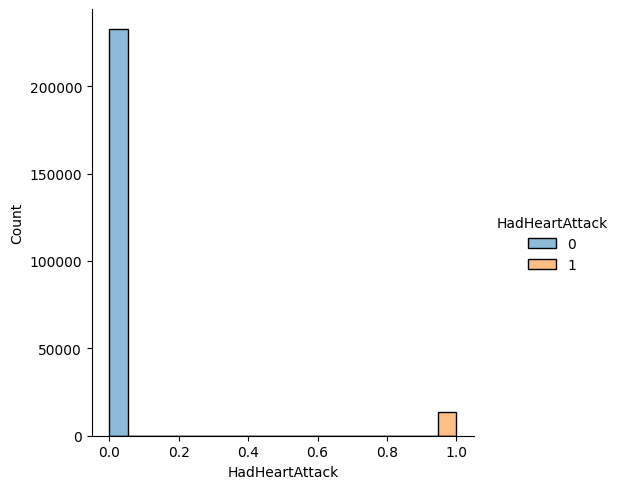

In [31]:
sn.displot(data, x="HadHeartAttack", hue='HadHeartAttack')

In [32]:
no_ha = data.loc[data['HadHeartAttack'] == 0].sample(n = 13435, random_state=33)
ha = data.loc[data['HadHeartAttack'] == 1]
frames = [ha,no_ha]
data = pd.concat(frames)

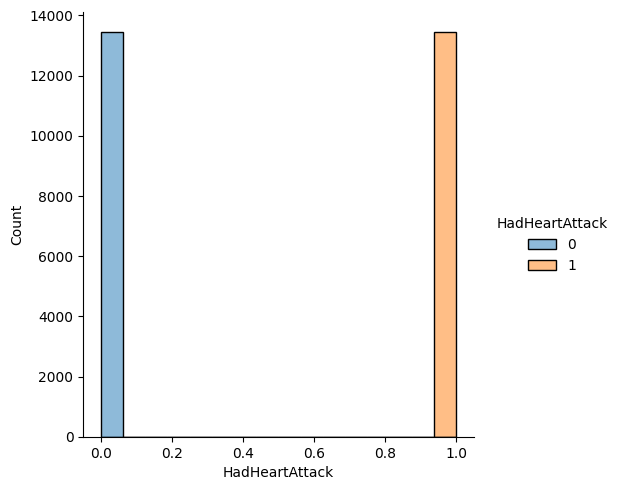

In [33]:
sn.displot(data, x="HadHeartAttack", hue='HadHeartAttack')

In [34]:
data.shape

(26870, 40)

In [35]:
data['HadHeartAttack'].value_counts()

HadHeartAttack
1    13435
0    13435
Name: count, dtype: int64

In [36]:
data

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
7,1,1,4,5.0,0.0,1,1,8.0,1,1,...,1.75,74.84,24.37,0,1,1,1,4,0,1
12,1,1,3,5.0,0.0,1,1,5.0,2,1,...,1.88,115.67,32.74,0,0,1,1,3,0,2
34,1,1,3,0.0,0.0,1,1,6.0,1,1,...,1.78,71.67,22.67,0,0,1,1,1,0,2
37,1,1,3,3.0,27.0,1,1,5.0,2,1,...,1.85,123.83,36.02,0,0,1,0,3,0,1
43,1,1,3,0.0,0.0,1,1,8.0,1,1,...,1.78,95.25,30.13,0,1,1,1,3,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93521,21,2,3,0.0,1.0,1,0,6.0,4,0,...,1.68,83.01,29.54,1,0,1,1,3,0,3
191893,44,1,3,0.0,0.0,1,1,8.0,4,0,...,1.88,90.72,25.68,1,0,1,1,3,0,1
203133,45,1,3,0.0,0.0,1,1,7.0,4,0,...,1.65,68.04,24.96,1,0,1,0,4,0,2
187853,43,1,2,0.0,0.0,1,0,6.0,4,0,...,1.68,63.50,22.60,0,1,0,0,4,0,2


In [37]:
N=13435*2
data=data.sample(n = N, random_state=33)

In [38]:
data['HadHeartAttack'].value_counts()

HadHeartAttack
0    13435
1    13435
Name: count, dtype: int64

In [39]:
data[0:10]

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadHeartAttack,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
57747,15,1,1,5.0,0.0,3,1,6.0,1,0,...,1.78,90.72,28.70,1,1,0,0,1,1,1
194270,44,2,3,0.0,0.0,1,1,9.0,4,0,...,1.55,111.13,46.29,0,1,1,0,4,0,2
134406,30,1,1,0.0,0.0,1,1,7.0,1,0,...,1.70,74.84,25.84,0,0,1,0,4,0,2
23565,6,1,3,4.0,2.0,3,1,7.0,4,0,...,1.80,77.11,23.80,1,0,1,0,3,0,2
79090,19,2,5,30.0,30.0,1,0,4.0,1,0,...,1.57,72.57,29.26,0,1,0,1,3,0,1
130703,29,2,2,0.0,0.0,1,1,10.0,1,1,...,1.68,74.84,26.63,1,0,1,1,4,0,2
89856,21,2,2,3.0,2.0,1,1,8.0,4,0,...,1.57,113.40,45.73,0,1,1,1,1,0,1
105886,24,1,3,0.0,1.0,1,0,6.0,1,1,...,1.75,79.38,25.84,1,1,1,1,4,0,2
91995,21,1,3,0.0,1.0,1,1,8.0,4,1,...,1.78,117.93,37.31,0,1,1,1,1,0,3
207916,46,1,3,0.0,0.0,1,1,9.0,4,1,...,1.80,88.45,27.20,1,0,1,0,3,0,2


## Heatmap

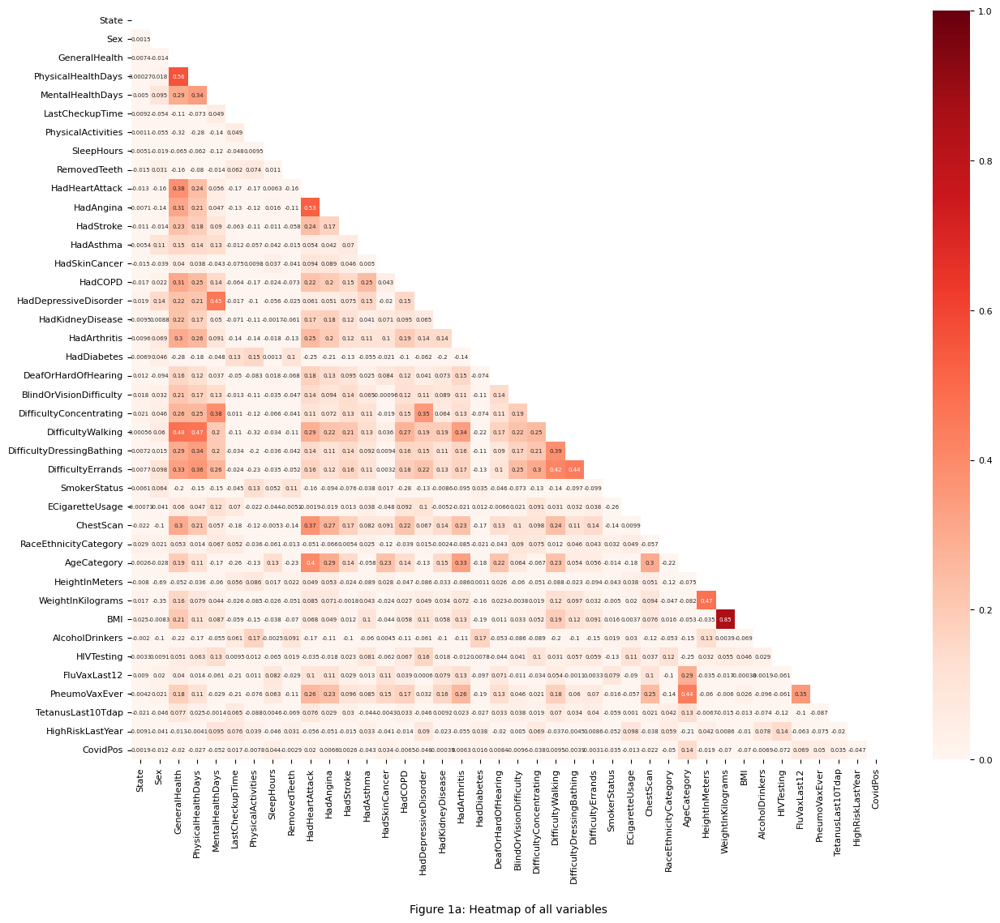

In [40]:
plt.rc('xtick', labelsize=8)   # fontsize of the tick labels
plt.rc('ytick', labelsize=8)  # fontsize of the tick labels
plt.figure(figsize=(15, 12))

plt.annotate('Figure 1a: Heatmap of all variables',
            xy = (0.5, -0.2),
            xycoords='axes fraction',
            ha='center',
            va="center",
            fontsize=10)

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(data.corr()))
heatmap = sn.heatmap(data.corr(), mask=mask, vmin=0, vmax=1, annot=True, cmap='Reds', annot_kws={"size": 5})

In [41]:
data['HadHeartAttack'].value_counts()

HadHeartAttack
0    13435
1    13435
Name: count, dtype: int64

## Split Data into Test, Train, Validate

In [42]:
data.shape

(26870, 40)

In [43]:
print(26870*.7)
print(26870*.2)
print(26870*.1)

18809.0
5374.0
2687.0


In [44]:
x_train=data[0:18809]
y_train= x_train.iloc[:,9]
x_train=x_train.loc[:, data.columns!='HadHeartAttack']

x_test=data[18809:24183]
y_test= x_test.iloc[:,9]
x_test=x_test.loc[:, data.columns!='HadHeartAttack']

x_val=data[24183:26870]
y_val= x_val.iloc[:,9]
x_val=x_val.loc[:, data.columns!='HadHeartAttack']

In [45]:
x_train

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadAngina,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
57747,15,1,1,5.0,0.0,3,1,6.0,1,0,...,1.78,90.72,28.70,1,1,0,0,1,1,1
194270,44,2,3,0.0,0.0,1,1,9.0,4,0,...,1.55,111.13,46.29,0,1,1,0,4,0,2
134406,30,1,1,0.0,0.0,1,1,7.0,1,0,...,1.70,74.84,25.84,0,0,1,0,4,0,2
23565,6,1,3,4.0,2.0,3,1,7.0,4,1,...,1.80,77.11,23.80,1,0,1,0,3,0,2
79090,19,2,5,30.0,30.0,1,0,4.0,1,0,...,1.57,72.57,29.26,0,1,0,1,3,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79017,19,1,4,12.0,0.0,2,1,9.0,2,1,...,1.70,83.46,28.82,0,0,0,0,3,0,1
71956,17,2,4,0.0,15.0,1,0,5.0,1,0,...,1.63,90.72,34.33,1,1,0,0,4,1,1
162498,36,2,3,14.0,0.0,2,0,5.0,3,0,...,1.68,71.67,25.50,0,1,0,1,3,0,2
240221,52,1,2,0.0,0.0,1,1,6.0,1,1,...,1.78,83.91,26.54,1,1,1,1,1,0,2


In [46]:
x_test

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadAngina,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
42673,11,2,5,30.0,3.0,1,1,10.0,1,0,...,1.57,58.97,23.78,0,0,0,1,4,0,2
240161,52,2,5,30.0,0.0,2,1,10.0,4,1,...,1.47,56.70,26.12,0,0,1,1,3,0,1
126186,28,1,3,0.0,0.0,1,1,8.0,1,0,...,1.73,74.84,25.09,1,0,1,0,4,0,2
86686,21,2,1,0.0,0.0,1,1,5.0,1,1,...,1.50,58.06,25.85,1,0,0,1,3,0,2
76530,19,2,2,0.0,0.0,1,1,6.0,4,0,...,1.75,103.42,33.67,0,0,1,0,4,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168369,37,2,5,30.0,10.0,1,0,7.0,1,0,...,1.63,77.56,29.35,1,0,1,1,4,0,2
30168,8,2,4,3.0,2.0,1,1,6.0,2,1,...,1.63,62.60,23.69,0,0,1,1,4,0,2
71334,17,1,2,0.0,0.0,1,1,7.0,4,1,...,1.96,81.65,21.34,0,0,1,0,1,0,1
222407,48,1,2,0.0,0.0,1,1,9.0,4,0,...,1.91,133.81,36.87,0,1,1,1,3,0,3


In [47]:
x_val

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadAngina,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
179148,41,1,4,0.0,0.0,2,0,6.0,1,1,...,1.73,127.01,42.57,0,0,1,1,1,0,2
7,1,1,4,5.0,0.0,1,1,8.0,1,1,...,1.75,74.84,24.37,0,1,1,1,4,0,1
138290,31,2,1,0.0,0.0,1,1,7.0,1,0,...,1.65,67.13,24.63,1,0,1,1,3,0,2
237949,51,1,1,0.0,0.0,1,1,9.0,1,0,...,1.68,63.50,22.60,0,0,1,0,4,0,1
178382,41,1,1,0.0,0.0,1,1,6.0,3,0,...,1.83,81.65,24.41,0,0,1,1,1,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
788,1,1,3,0.0,0.0,1,1,7.0,2,0,...,1.75,80.74,26.29,1,1,1,1,1,0,2
9513,3,1,4,20.0,0.0,1,1,6.0,1,0,...,1.55,54.43,22.67,1,0,0,1,4,0,2
105895,24,1,4,0.0,0.0,1,0,9.0,3,1,...,1.70,104.33,36.02,0,0,1,1,3,0,2
42268,11,2,4,3.0,30.0,1,0,8.0,2,1,...,1.63,65.77,24.89,0,0,1,0,4,0,2


## ANOVA F-Test

In [48]:
x_train_anova=x_train
x_test_anova=x_test
y_train_anova=y_train
y_test_anova=y_test
x_val_anova=x_val
y_val_anova=y_val

In [49]:
y_train_anova

57747     0
194270    0
134406    0
23565     0
79090     0
         ..
79017     1
71956     0
162498    1
240221    1
103484    0
Name: HadHeartAttack, Length: 18809, dtype: object

In [50]:
anovaFTest=SelectKBest(score_func=f_classif, k=10)
anovaFTest.fit(x_train_anova, y_train_anova)
anovaFTest.transform(x_train_anova).shape

(18809, 10)

In [51]:
x_train_anova

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadAngina,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
57747,15,1,1,5.0,0.0,3,1,6.0,1,0,...,1.78,90.72,28.70,1,1,0,0,1,1,1
194270,44,2,3,0.0,0.0,1,1,9.0,4,0,...,1.55,111.13,46.29,0,1,1,0,4,0,2
134406,30,1,1,0.0,0.0,1,1,7.0,1,0,...,1.70,74.84,25.84,0,0,1,0,4,0,2
23565,6,1,3,4.0,2.0,3,1,7.0,4,1,...,1.80,77.11,23.80,1,0,1,0,3,0,2
79090,19,2,5,30.0,30.0,1,0,4.0,1,0,...,1.57,72.57,29.26,0,1,0,1,3,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79017,19,1,4,12.0,0.0,2,1,9.0,2,1,...,1.70,83.46,28.82,0,0,0,0,3,0,1
71956,17,2,4,0.0,15.0,1,0,5.0,1,0,...,1.63,90.72,34.33,1,1,0,0,4,1,1
162498,36,2,3,14.0,0.0,2,0,5.0,3,0,...,1.68,71.67,25.50,0,1,0,1,3,0,2
240221,52,1,2,0.0,0.0,1,1,6.0,1,1,...,1.78,83.91,26.54,1,1,1,1,1,0,2


In [52]:
x_test_anova.shape

(5374, 39)

In [53]:
a=anovaFTest.get_support().tolist()
b=x_train_anova.columns.tolist()
selectedVars=[]
i=0

while i < len(a):
    if a[i]==True:
        selectedVars.append(b[i])
    i=i+1

In [54]:
selectedVars

['GeneralHealth',
 'PhysicalHealthDays',
 'HadAngina',
 'HadStroke',
 'HadArthritis',
 'HadDiabetes',
 'DifficultyWalking',
 'ChestScan',
 'AgeCategory',
 'PneumoVaxEver']

In [55]:
x_train_anova=x_train_anova[selectedVars]
x_test_anova=x_test_anova[selectedVars]

x_val_anova=x_val_anova[selectedVars]
x_val_anova=x_val_anova[selectedVars]

In [56]:
x_train_anova

,GeneralHealth,PhysicalHealthDays,HadAngina,HadStroke,HadArthritis,HadDiabetes,DifficultyWalking,ChestScan,AgeCategory,PneumoVaxEver
57747,1,5.0,0,0,0,3,0,1,8,0
194270,3,0.0,0,0,0,3,0,0,4,0
134406,1,0.0,0,0,0,3,0,0,10,0
23565,3,4.0,1,0,0,3,0,1,5,0
79090,5,30.0,0,0,1,3,1,1,7,1
...,...,...,...,...,...,...,...,...,...,...
79017,4,12.0,1,0,0,3,0,0,11,0
71956,4,0.0,0,0,1,3,1,1,3,0
162498,3,14.0,0,1,0,4,1,1,9,1
240221,2,0.0,1,0,1,1,0,1,8,1


In [57]:
x_test_anova

,GeneralHealth,PhysicalHealthDays,HadAngina,HadStroke,HadArthritis,HadDiabetes,DifficultyWalking,ChestScan,AgeCategory,PneumoVaxEver
42673,5,30.0,0,0,0,1,0,1,12,1
240161,5,30.0,1,0,1,1,1,1,9,1
126186,3,0.0,0,0,1,3,0,0,12,0
86686,1,0.0,1,1,0,3,0,0,12,1
76530,2,0.0,0,0,0,3,0,1,9,0
...,...,...,...,...,...,...,...,...,...,...
168369,5,30.0,0,0,1,3,0,1,9,1
30168,4,3.0,1,0,0,2,0,1,13,1
71334,2,0.0,1,0,0,3,0,0,10,0
222407,2,0.0,0,0,0,1,0,0,9,1


In [58]:
y_train_anova = y_train_anova.astype('int')
y_test_anova = y_test_anova.astype('int')
y_val_anova = y_val_anova.astype('int')

In [59]:
pModel=CalibratedClassifierCV(Perceptron())
pModel=pModel.fit(x_train_anova, y_train_anova)
pResults=pModel.predict(x_test_anova)

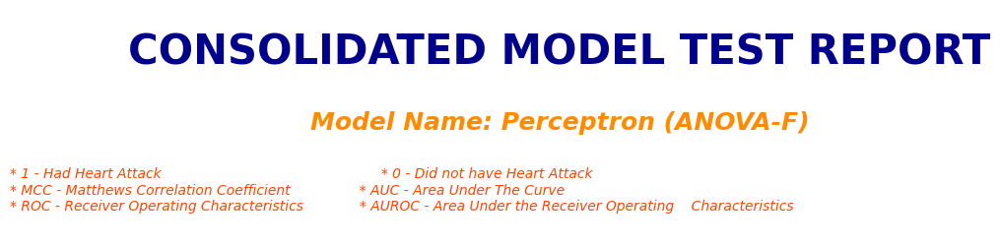

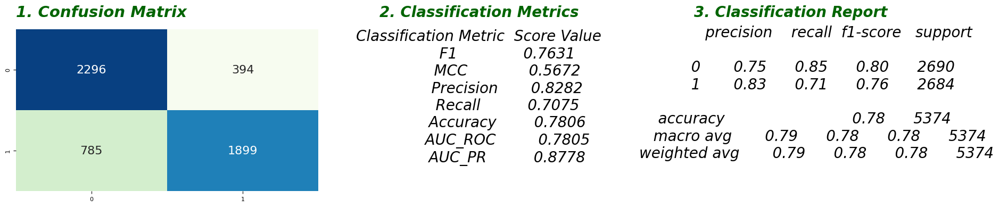

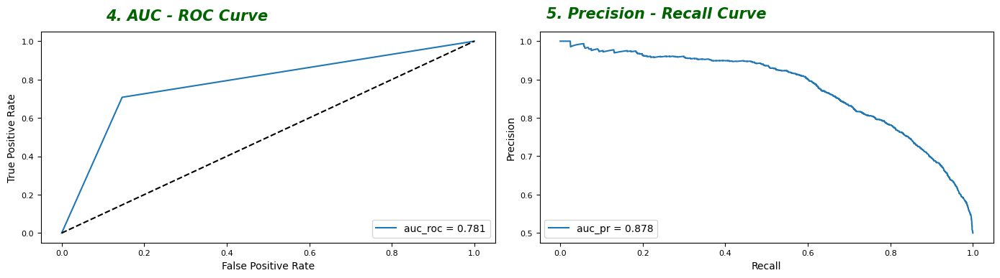

In [60]:
anova_test_percep=Generate_Model_Test_Classification_Report(pModel, x_test_anova, y_test_anova, 'Perceptron (ANOVA-F)')

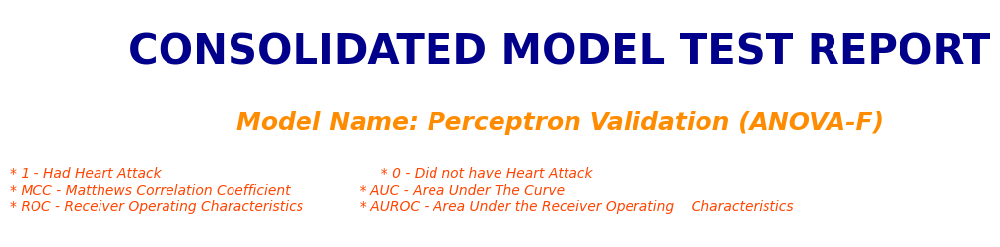

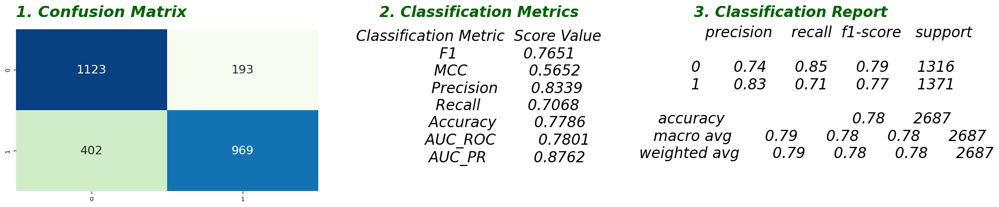

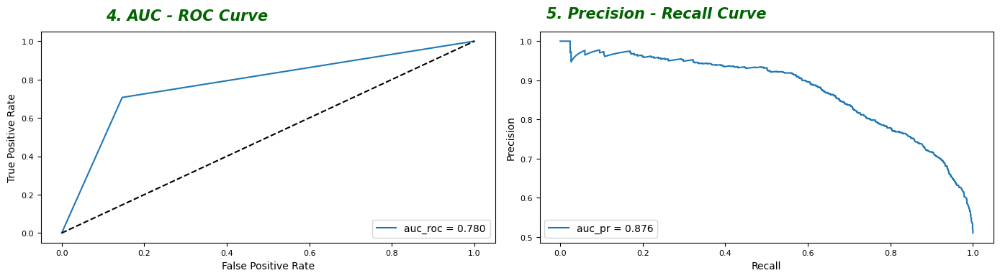

In [61]:
anova_pm = Generate_Model_Test_Classification_Report(pModel, x_val_anova, y_val_anova, 'Perceptron Validation (ANOVA-F)')

In [62]:
from sklearn.linear_model import SGDClassifier

In [63]:
sgdModel=SGDClassifier(loss='log_loss')
sgdModel=sgdModel.fit(x_train_anova, y_train_anova)
sgdResults=sgdModel.predict(x_test_anova)

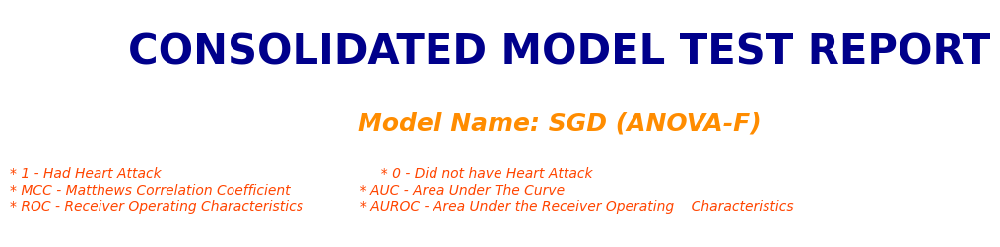

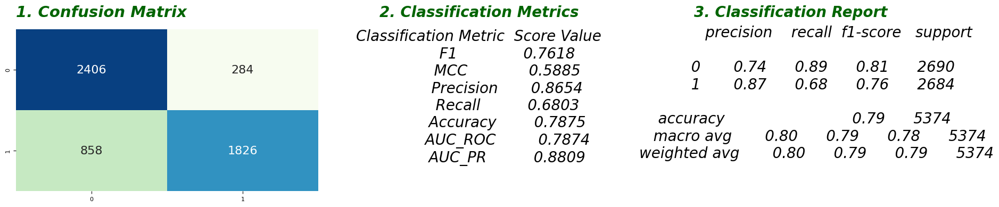

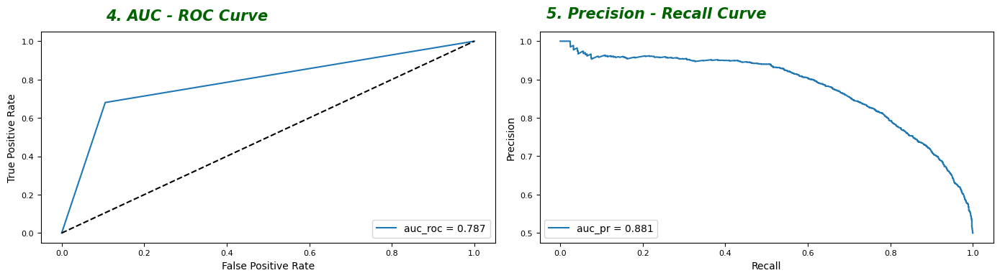

In [64]:
anova_test_sgd=Generate_Model_Test_Classification_Report(sgdModel, x_test_anova, y_test_anova, 'SGD (ANOVA-F)')

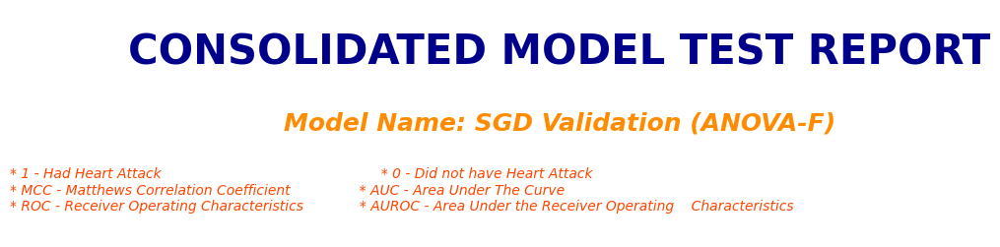

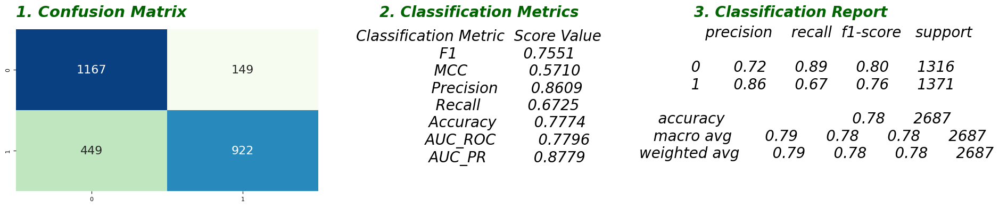

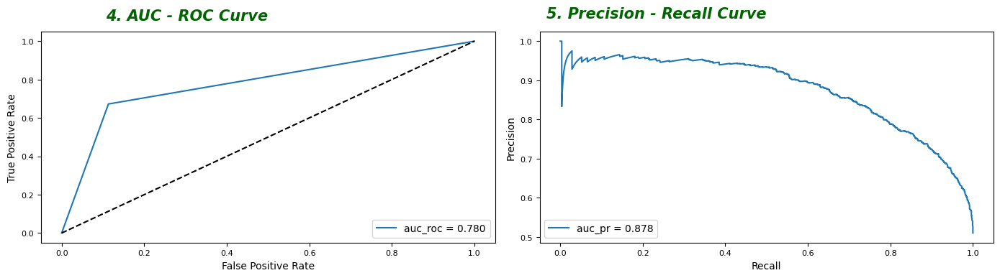

In [65]:
anova_sgd= Generate_Model_Test_Classification_Report(sgdModel, x_val_anova, y_val_anova, 'SGD Validation (ANOVA-F)')

In [66]:
from sklearn.linear_model import LogisticRegression

In [67]:
lrModel=LogisticRegression(max_iter=30000)
lrModel=lrModel.fit(x_train_anova, y_train_anova)
lrResults=lrModel.predict(x_test_anova)

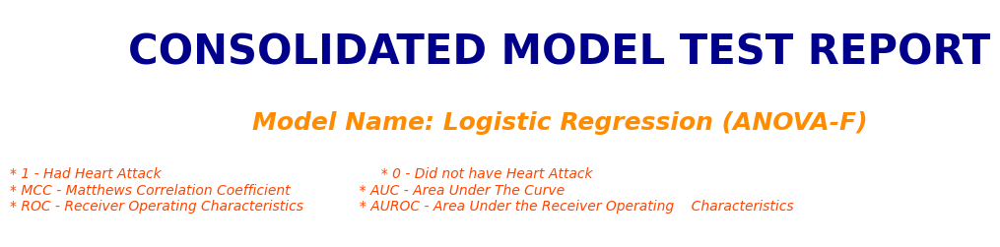

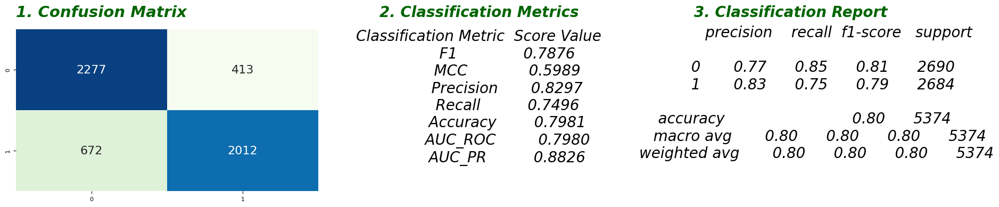

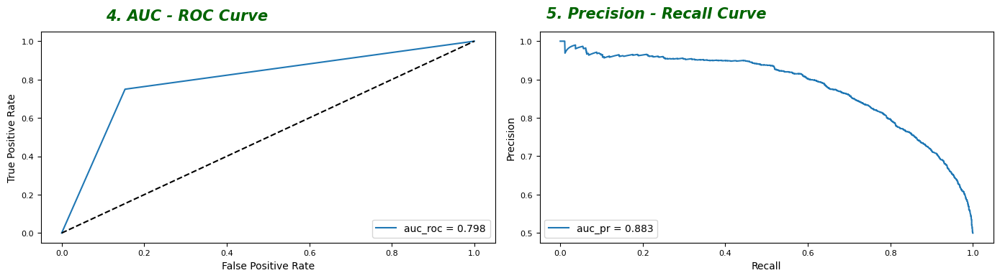

In [68]:
anova_test_lr=Generate_Model_Test_Classification_Report(lrModel, x_test_anova, y_test_anova, 'Logistic Regression (ANOVA-F)')

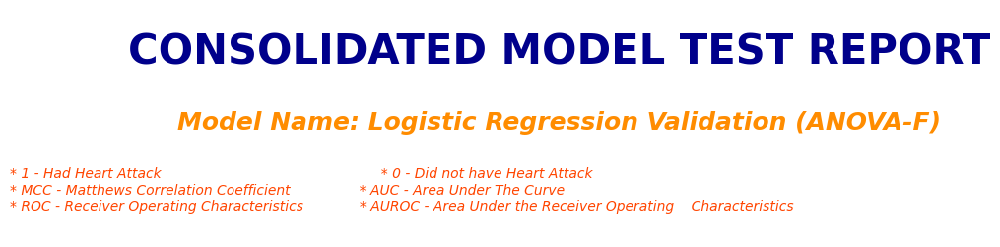

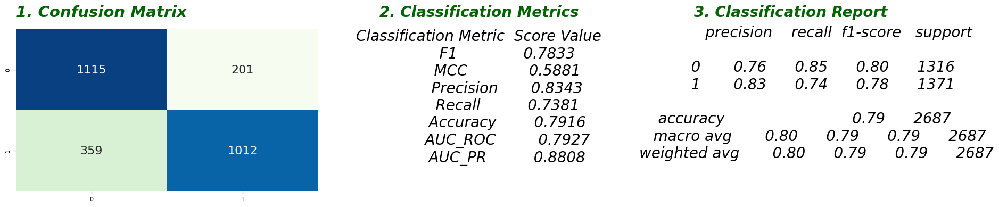

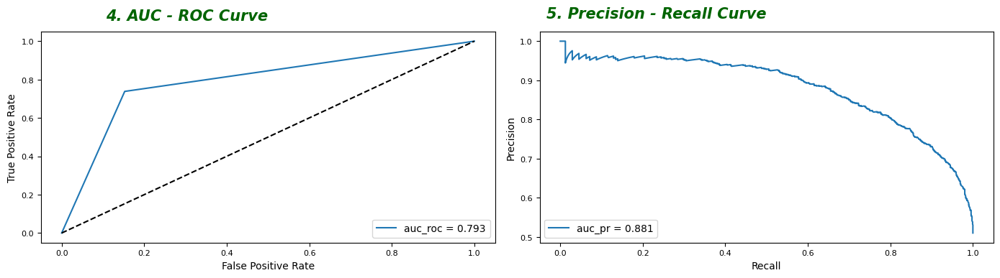

In [69]:
anova_lr = Generate_Model_Test_Classification_Report(lrModel, x_val_anova, y_val_anova, 'Logistic Regression Validation (ANOVA-F)')

In [70]:
from sklearn.svm import LinearSVC
x_train_anova.shape

(18809, 10)

In [71]:
svmModel=CalibratedClassifierCV(LinearSVC(max_iter=300000))
svmModel=svmModel.fit(x_train_anova, y_train_anova)
svmResults=svmModel.predict(x_test_anova)

The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.


In [72]:
x_train_anova.shape

(18809, 10)

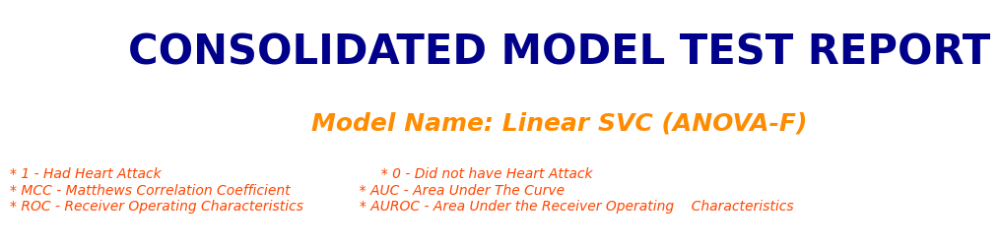

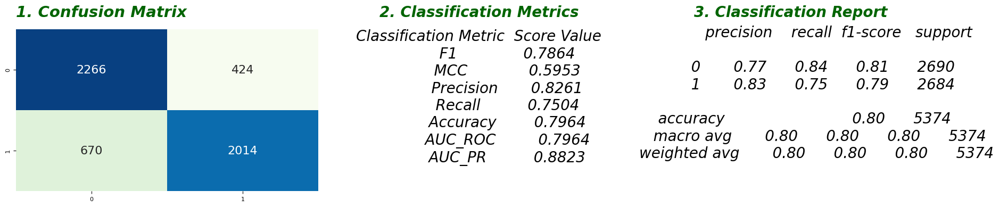

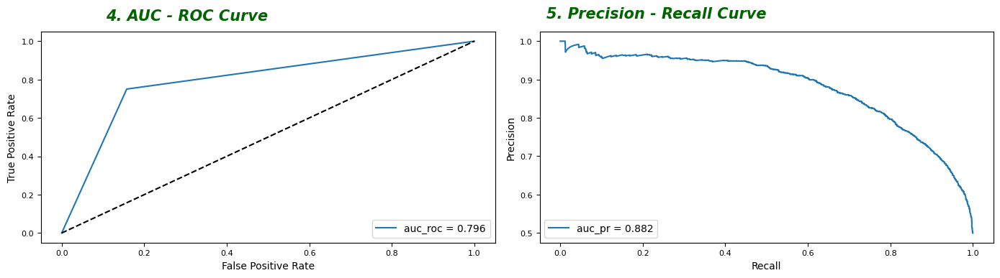

In [73]:
anova_test_svm=Generate_Model_Test_Classification_Report(svmModel, x_test_anova, y_test_anova, 'Linear SVC (ANOVA-F)')

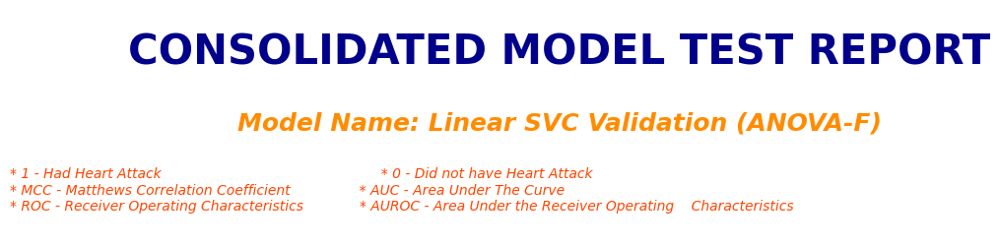

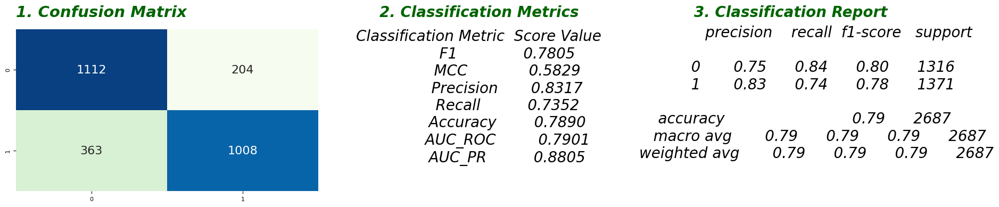

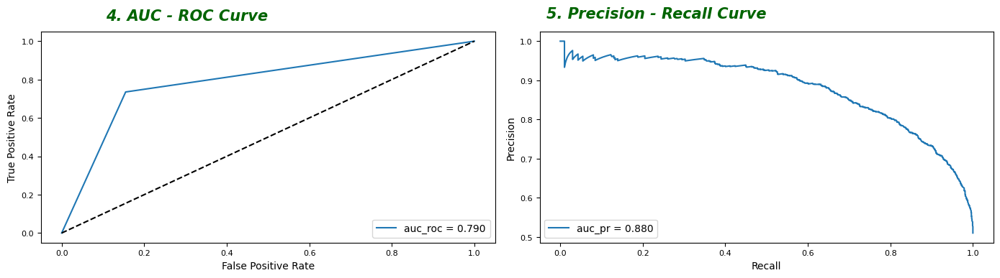

In [74]:
anova_svm = Generate_Model_Test_Classification_Report(svmModel, x_val_anova, y_val_anova, 'Linear SVC Validation (ANOVA-F)')

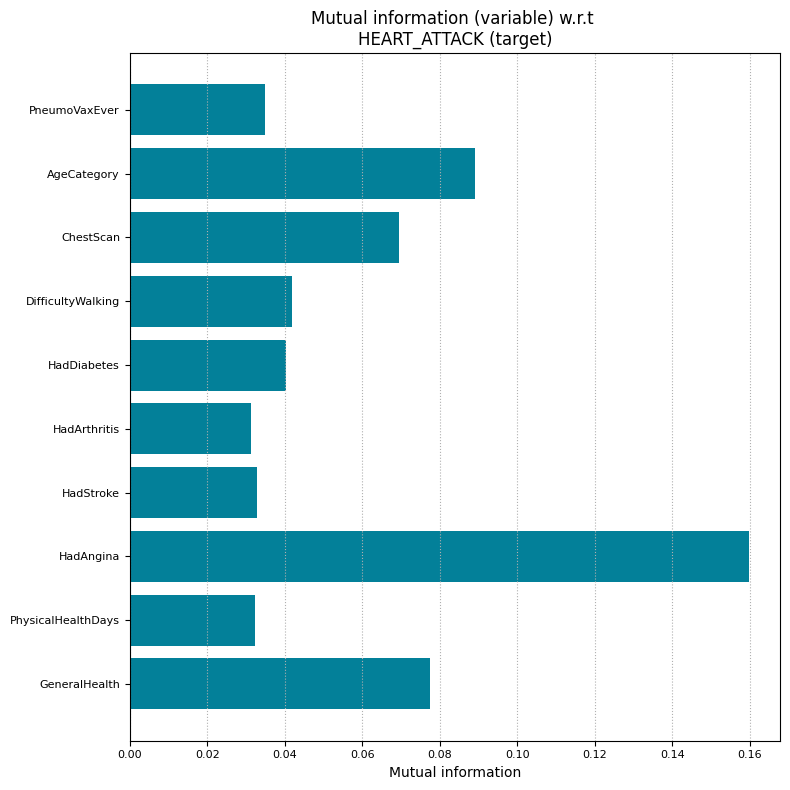

In [104]:
from sklearn.feature_selection import mutual_info_classif
anova_opLabel = np.array(data['HadHeartAttack']).astype('int')
anova_data = data[selectedVars]
MI_features = anova_data.columns 
mutual_infos = (mutual_info_classif(X=anova_data,
                                    y=anova_opLabel, 
                                    n_neighbors=10,
                                    random_state=20))
plt.figure(figsize=(8, 8))
plt.barh(y=MI_features, width=mutual_infos, color="#038099")
plt.title("Mutual information (variable) w.r.t \nHEART_ATTACK (target)");
plt.xlabel("Mutual information")
plt.gca().xaxis.grid(True, linestyle=':');
plt.tight_layout();

In [105]:
results_anova=[anova_pm[0],
         anova_sgd[0],
         anova_lr[0],
         anova_svm[0],]
models = ['Perceptron','SGD Tree','Logistic Regression','Linear SVC Validation']
results_anova = pd.DataFrame(data = results_anova)
results_anova.columns = ['F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']
results_anova['Models'] = models
results_anova = results_anova[['Models','F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']]
results_anova

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.765101,0.565191,0.833907,0.706783,0.778563,0.780063,0.876229
1,SGD Tree,0.755119,0.571032,0.860878,0.672502,0.777447,0.779640,0.877851
2,Logistic Regression,0.783282,0.588070,0.834295,0.738147,0.791589,0.792706,0.880787
3,Linear SVC Validation,0.780488,0.582892,0.831683,0.735230,0.788984,0.790107,0.880496


## Chi Squared

In [106]:
x_train_chisq=x_train
x_test_chisq=x_test
y_train_chisq=y_train
y_test_chisq=y_test
x_val_chisq=x_val
y_val_chisq=y_val

In [107]:
y_train_chisq = y_train_chisq.astype('int')
y_test_chisq = y_test_chisq.astype('int')
y_val_chisq = y_val_chisq.astype('int')

In [108]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.feature_selection import chi2

In [109]:
chisq=SelectKBest(score_func=chi2, k=10)
chisq.fit(x_train_chisq, y_train_chisq)


SelectKBest(score_func=<function chi2 at 0x177988680>)

In [110]:
x_train_chisq

,State,Sex,GeneralHealth,PhysicalHealthDays,MentalHealthDays,LastCheckupTime,PhysicalActivities,SleepHours,RemovedTeeth,HadAngina,...,HeightInMeters,WeightInKilograms,BMI,AlcoholDrinkers,HIVTesting,FluVaxLast12,PneumoVaxEver,TetanusLast10Tdap,HighRiskLastYear,CovidPos
57747,15,1,1,5.0,0.0,3,1,6.0,1,0,...,1.78,90.72,28.70,1,1,0,0,1,1,1
194270,44,2,3,0.0,0.0,1,1,9.0,4,0,...,1.55,111.13,46.29,0,1,1,0,4,0,2
134406,30,1,1,0.0,0.0,1,1,7.0,1,0,...,1.70,74.84,25.84,0,0,1,0,4,0,2
23565,6,1,3,4.0,2.0,3,1,7.0,4,1,...,1.80,77.11,23.80,1,0,1,0,3,0,2
79090,19,2,5,30.0,30.0,1,0,4.0,1,0,...,1.57,72.57,29.26,0,1,0,1,3,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79017,19,1,4,12.0,0.0,2,1,9.0,2,1,...,1.70,83.46,28.82,0,0,0,0,3,0,1
71956,17,2,4,0.0,15.0,1,0,5.0,1,0,...,1.63,90.72,34.33,1,1,0,0,4,1,1
162498,36,2,3,14.0,0.0,2,0,5.0,3,0,...,1.68,71.67,25.50,0,1,0,1,3,0,2
240221,52,1,2,0.0,0.0,1,1,6.0,1,1,...,1.78,83.91,26.54,1,1,1,1,1,0,2


In [111]:
a=chisq.get_support().tolist()
b=x_train_chisq.columns.tolist()

selectedVars2=[]
i=0

while i < len(a):
    if a[i]==True:
        selectedVars2.append(b[i])
    i=i+1

In [112]:
selectedVars2

['GeneralHealth',
 'PhysicalHealthDays',
 'MentalHealthDays',
 'HadAngina',
 'HadStroke',
 'HadCOPD',
 'DifficultyWalking',
 'ChestScan',
 'AgeCategory',
 'WeightInKilograms']

In [113]:
chisq.get_support()

array([False, False,  True,  True,  True, False, False, False, False,
        True,  True, False, False,  True, False, False, False, False,
       False, False, False,  True, False, False, False, False,  True,
       False,  True, False,  True, False, False, False, False, False,
       False, False, False])

In [114]:
x_train_chisq=x_train_chisq[selectedVars2]
x_test_chisq=x_test_chisq[selectedVars2]

x_val_chisq=x_val_chisq[selectedVars2]
x_val_chisq=x_val_chisq[selectedVars2]

In [115]:
x_train_chisq

,GeneralHealth,PhysicalHealthDays,MentalHealthDays,HadAngina,HadStroke,HadCOPD,DifficultyWalking,ChestScan,AgeCategory,WeightInKilograms
57747,1,5.0,0.0,0,0,0,0,1,8,90.72
194270,3,0.0,0.0,0,0,0,0,0,4,111.13
134406,1,0.0,0.0,0,0,0,0,0,10,74.84
23565,3,4.0,2.0,1,0,0,0,1,5,77.11
79090,5,30.0,30.0,0,0,0,1,1,7,72.57
...,...,...,...,...,...,...,...,...,...,...
79017,4,12.0,0.0,1,0,0,0,0,11,83.46
71956,4,0.0,15.0,0,0,0,1,1,3,90.72
162498,3,14.0,0.0,0,1,0,1,1,9,71.67
240221,2,0.0,0.0,1,0,0,0,1,8,83.91


In [116]:
x_test_chisq

,GeneralHealth,PhysicalHealthDays,MentalHealthDays,HadAngina,HadStroke,HadCOPD,DifficultyWalking,ChestScan,AgeCategory,WeightInKilograms
42673,5,30.0,3.0,0,0,0,0,1,12,58.97
240161,5,30.0,0.0,1,0,0,1,1,9,56.70
126186,3,0.0,0.0,0,0,0,0,0,12,74.84
86686,1,0.0,0.0,1,1,0,0,0,12,58.06
76530,2,0.0,0.0,0,0,0,0,1,9,103.42
...,...,...,...,...,...,...,...,...,...,...
168369,5,30.0,10.0,0,0,0,0,1,9,77.56
30168,4,3.0,2.0,1,0,0,0,1,13,62.60
71334,2,0.0,0.0,1,0,0,0,0,10,81.65
222407,2,0.0,0.0,0,0,0,0,0,9,133.81


In [117]:
pModel=CalibratedClassifierCV(Perceptron())
pModel=pModel.fit(x_train_chisq, y_train_chisq)
pResults=pModel.predict(x_test_chisq)

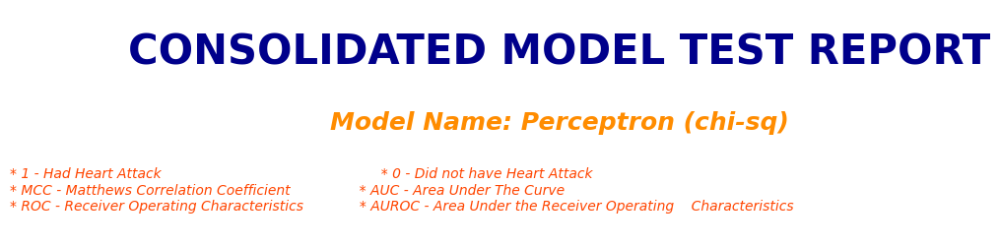

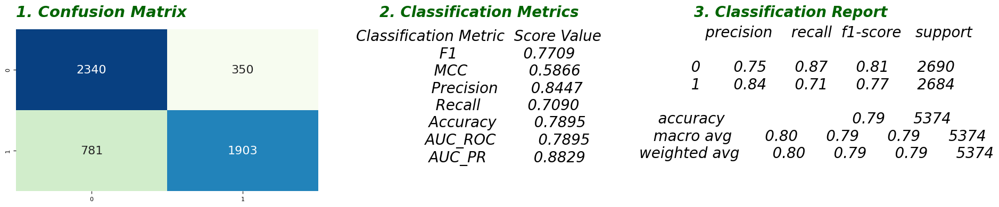

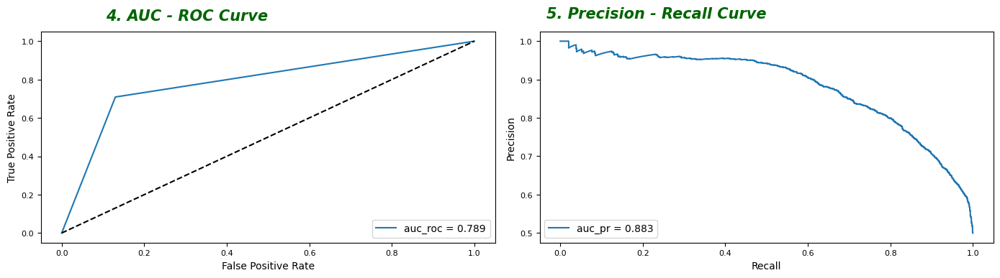

In [118]:
chisq_test_percep=Generate_Model_Test_Classification_Report(pModel, X_test=x_test_chisq, y_test=y_test_chisq, model_name='Perceptron (chi-sq)')

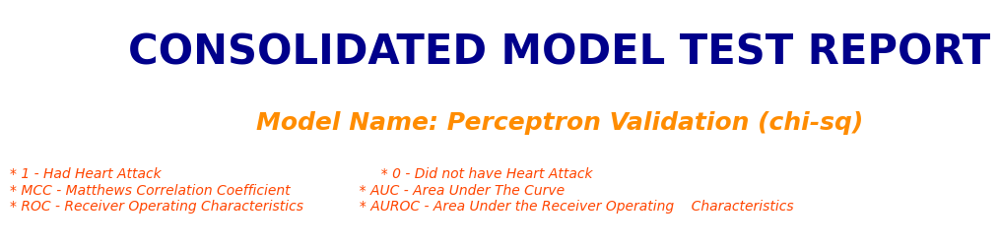

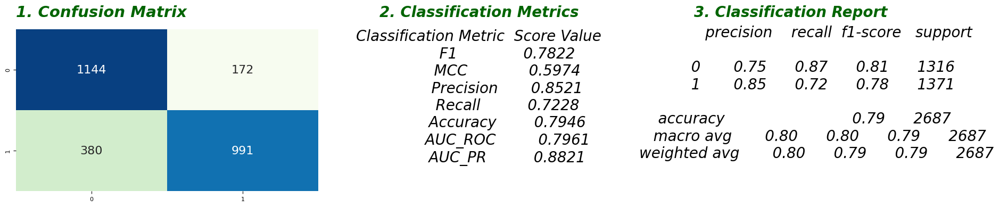

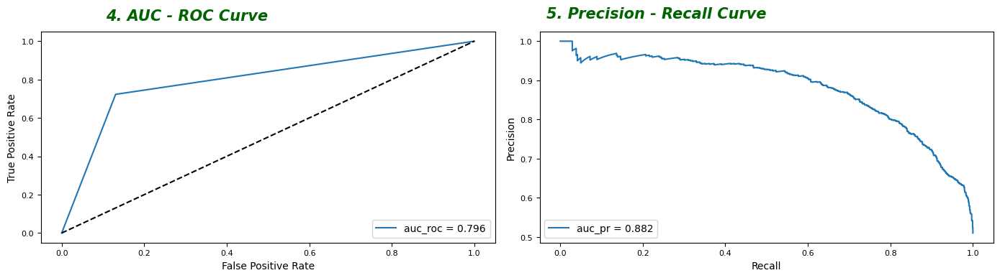

In [119]:
chisq_pm = Generate_Model_Test_Classification_Report(pModel, x_val_chisq, y_val_chisq, 'Perceptron Validation (chi-sq)')

In [120]:
sgdModel=SGDClassifier(loss='log_loss')
sgdModel=sgdModel.fit(x_train_chisq, y_train_chisq)
sgdResults=sgdModel.predict(x_test_chisq)

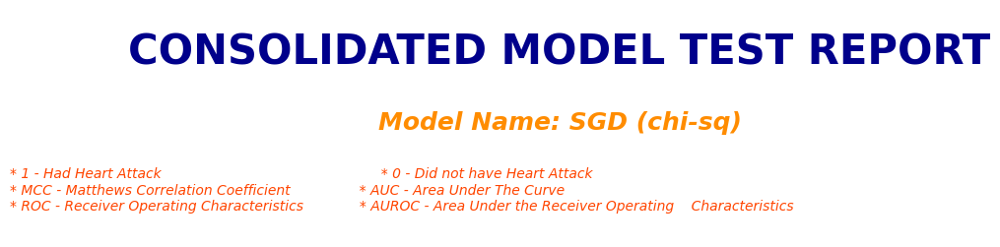

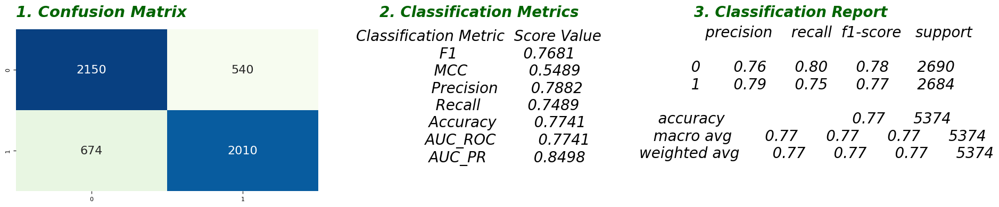

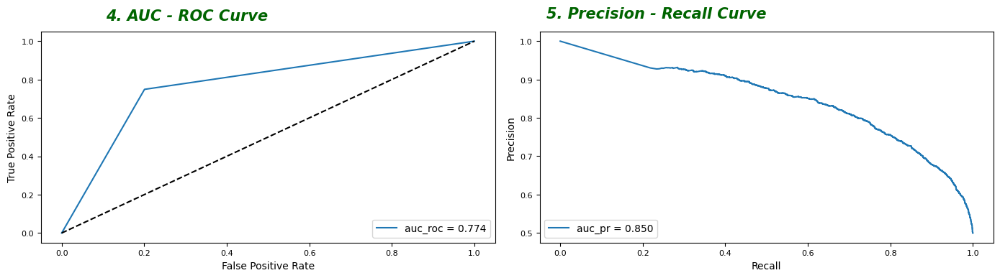

In [121]:
chisq_test_sgd=Generate_Model_Test_Classification_Report(sgdModel, X_test=x_test_chisq, y_test=y_test_chisq, model_name='SGD (chi-sq)')

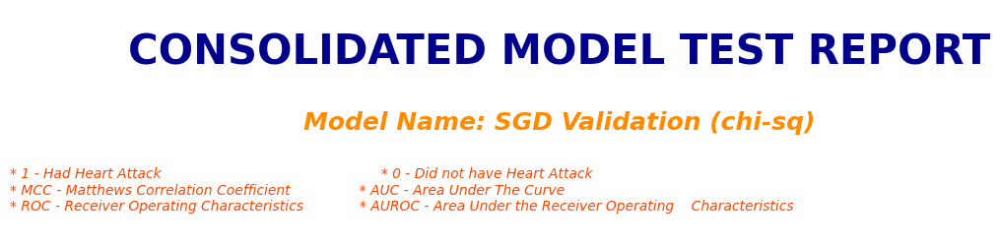

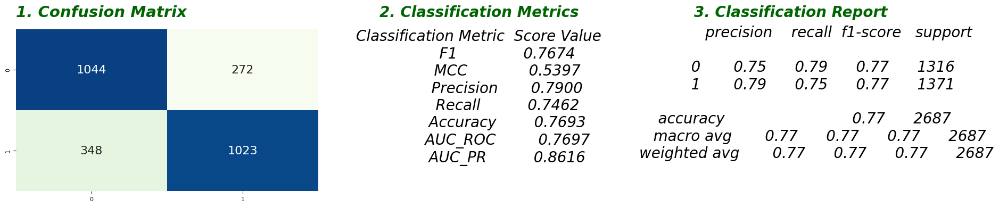

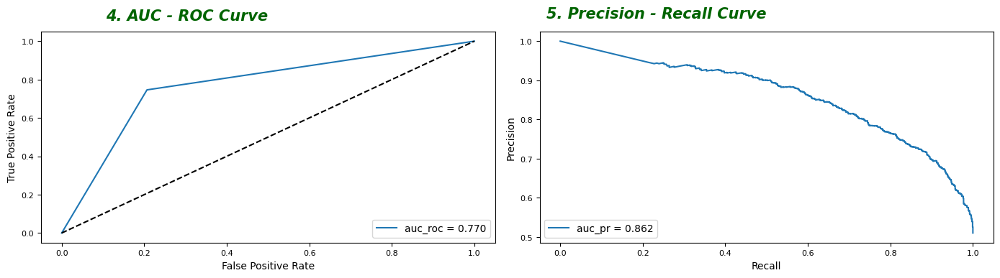

In [122]:
chisq_sgd = Generate_Model_Test_Classification_Report(sgdModel, x_val_chisq, y_val_chisq, 'SGD Validation (chi-sq)')

In [123]:
lrModel=LogisticRegression(max_iter=300000)
lrModel=lrModel.fit(x_train_chisq, y_train_chisq)
lrResults=lrModel.predict(x_test_chisq)

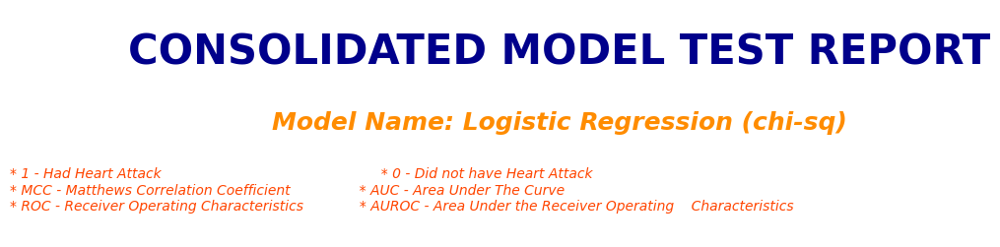

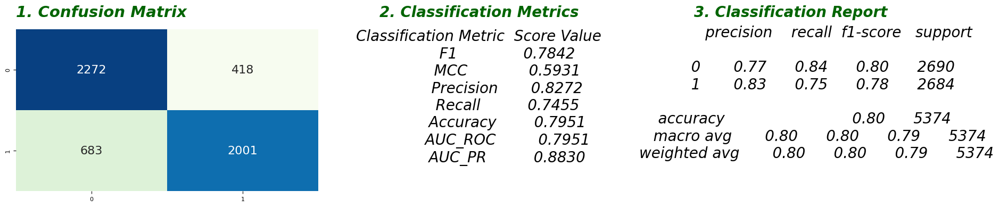

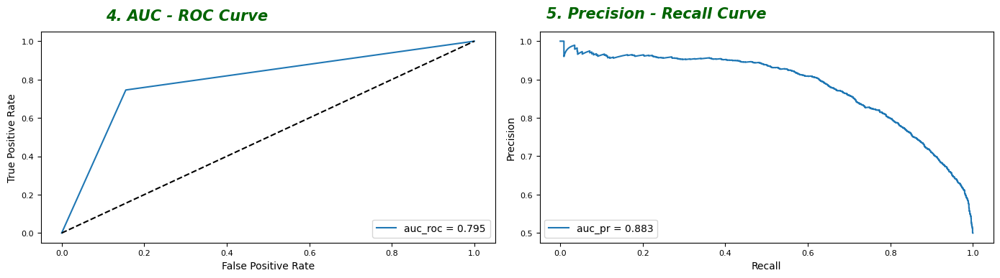

In [124]:
chisq_test_lr=Generate_Model_Test_Classification_Report(lrModel, X_test=x_test_chisq, y_test=y_test_chisq, model_name='Logistic Regression (chi-sq)')

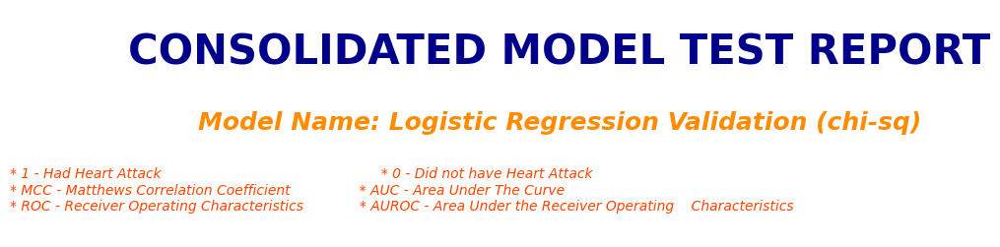

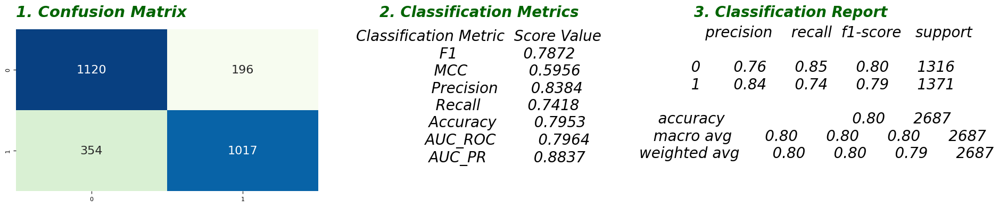

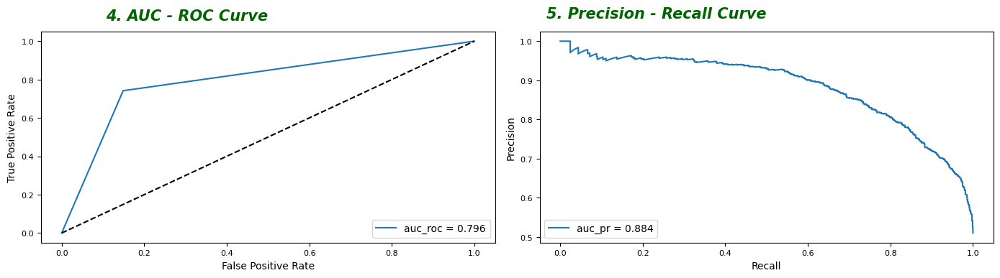

In [125]:
chisq_lr = Generate_Model_Test_Classification_Report(lrModel, x_val_chisq, y_val_chisq, 'Logistic Regression Validation (chi-sq)')

In [126]:
svmModel=CalibratedClassifierCV(LinearSVC(max_iter=50000))
svmModel=svmModel.fit(x_train_chisq, y_train_chisq)
svmResults=svmModel.predict(x_test_chisq)

The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
Liblinear failed to converge, increase the number of iterations.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
Liblinear failed to converge, increase the number of iterations.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
Liblinear failed to converge, increase the number of iterations.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
Liblinear failed to converge, increase the number of iterations.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
Liblinear failed to converge, increase the number of iterations.


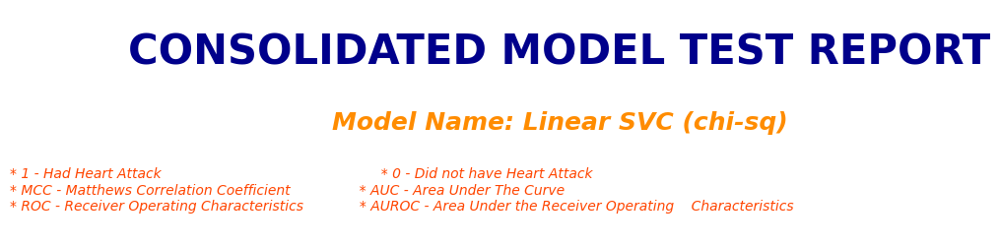

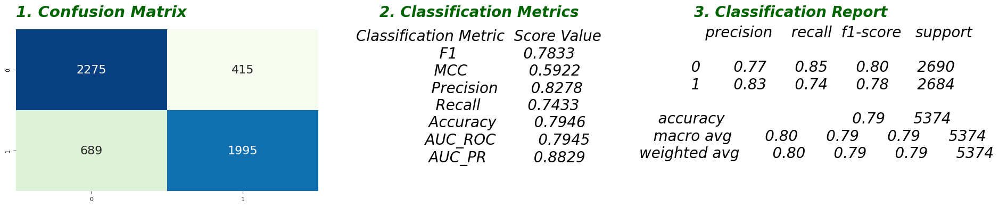

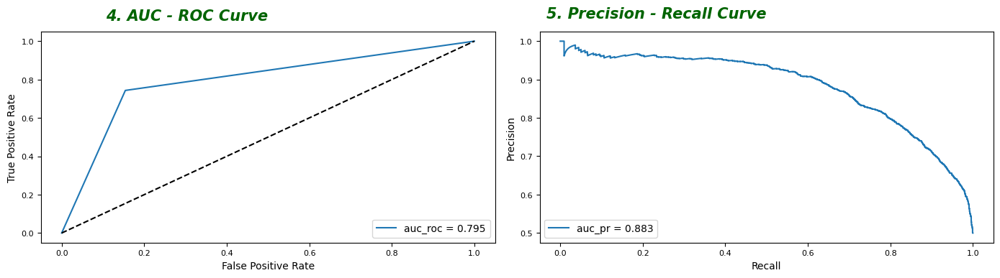

In [127]:
chisq_test_svm=Generate_Model_Test_Classification_Report(svmModel, X_test=x_test_chisq, y_test=y_test_chisq, model_name='Linear SVC (chi-sq)')

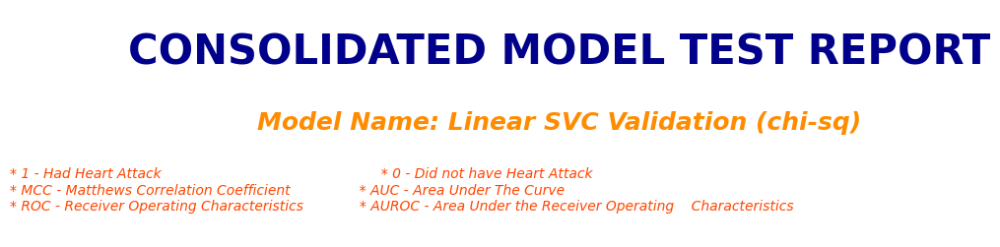

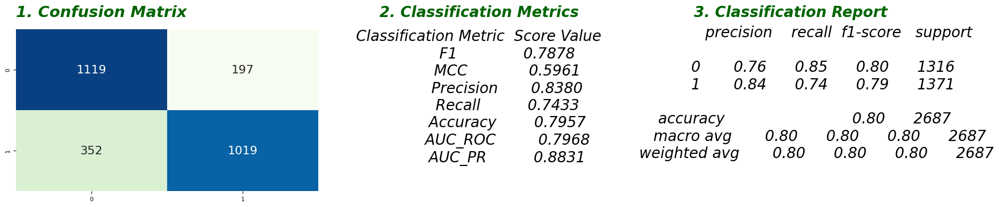

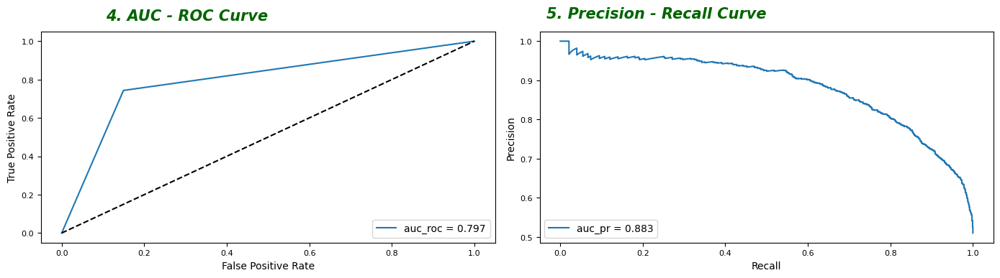

In [128]:
chisq_svm = Generate_Model_Test_Classification_Report(svmModel, x_val_chisq, y_val_chisq, 'Linear SVC Validation (chi-sq)')

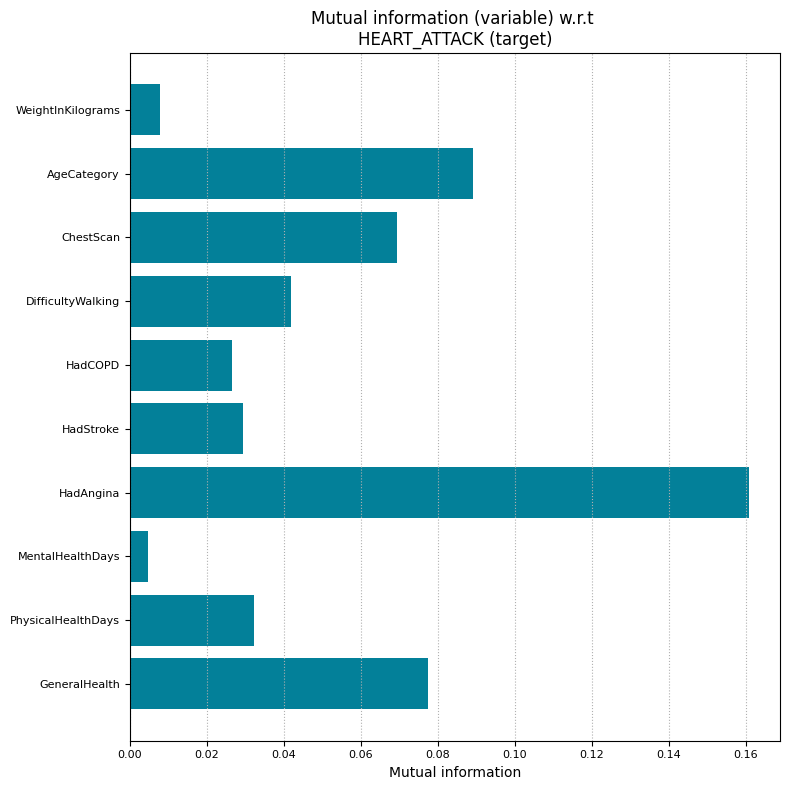

In [130]:
from sklearn.feature_selection import mutual_info_classif
opLabel = np.array(data['HadHeartAttack']).astype('int')
chi_data = data[selectedVars2]
MI_features = chi_data.columns 
mutual_infos = (mutual_info_classif(X=chi_data,
                                    y=opLabel, 
                                    n_neighbors=10,
                                    random_state=20))
plt.figure(figsize=(8, 8))
plt.barh(y=MI_features, width=mutual_infos, color="#038099")
plt.title("Mutual information (variable) w.r.t \nHEART_ATTACK (target)");
plt.xlabel("Mutual information")
plt.gca().xaxis.grid(True, linestyle=':');
plt.tight_layout();

In [131]:
results_chisq=[chisq_pm[0],
         chisq_sgd[0],
         chisq_lr[0],
         chisq_svm[0],]
models = ['Perceptron','SGD Tree','Logistic Regression','Linear SVC Validation']
results_chisq = pd.DataFrame(data = results_chisq)
results_chisq.columns = ['F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']
results_chisq['Models'] = models
results_chisq = results_chisq[['Models','F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']]
results_chisq

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.782163,0.597423,0.852107,0.722830,0.794566,0.796065,0.882123
1,SGD Tree,0.767442,0.539723,0.789961,0.746171,0.769259,0.769742,0.861592
2,Logistic Regression,0.787152,0.595550,0.838417,0.741794,0.795311,0.796429,0.883745
3,Linear SVC Validation,0.787785,0.596123,0.837993,0.743253,0.795683,0.796779,0.883108


In [132]:
results_anova

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.765101,0.565191,0.833907,0.706783,0.778563,0.780063,0.876229
1,SGD Tree,0.755119,0.571032,0.860878,0.672502,0.777447,0.779640,0.877851
2,Logistic Regression,0.783282,0.588070,0.834295,0.738147,0.791589,0.792706,0.880787
3,Linear SVC Validation,0.780488,0.582892,0.831683,0.735230,0.788984,0.790107,0.880496


### It seems that Chi Squared test preforms better overall

In [133]:
data["HadHeartAttack"]

57747     0
194270    0
134406    0
23565     0
79090     0
         ..
788       1
9513      1
105895    1
42268     1
55208     0
Name: HadHeartAttack, Length: 26870, dtype: object

In [134]:
#Data condensation using LASSO penalty
from sklearn.linear_model import Lasso, LogisticRegression
from sklearn import preprocessing

opLabel = np.array(data['HadHeartAttack'])
Lasso_data = data.drop(columns='HadHeartAttack')

featureVote = np.zeros(Lasso_data.shape[1])
print(featureVote.shape)

iteR = 100

for num in range(iteR):
    label0_indx = np.where(opLabel==0)[0]   #heart attack
    label1_indx = np.where(opLabel==1)[0]   #no heart attack
    numTrainData0 = 13000
    numTrainData1 = 13000
    np.random.shuffle(label0_indx)
    np.random.shuffle(label1_indx)

    label0_indx_train = label0_indx[0:numTrainData0-1]
    label1_indx_train = label1_indx[0:numTrainData1-1]
    label0_indx_test  = label0_indx[numTrainData0-1:]
    label1_indx_test  = label1_indx[numTrainData1-1:]

    testIndx  = np.append(label0_indx_test,label1_indx_test)
    trainIndx = np.append(label0_indx_train,label1_indx_train)
    trainData  =  Lasso_data.iloc[trainIndx]
    trainLabel =  opLabel[trainIndx]
    testData   =  Lasso_data.iloc[testIndx]
    testLabel  =  opLabel[testIndx]

    ##%% data standardization
    scaler = preprocessing.StandardScaler().fit(trainData)
    trainData_scaled = scaler.transform(trainData)
    testData_scaled  = scaler.transform(testData)

    ##%% Lasso from scikit

    regr = Lasso(random_state=0, alpha=0.021, tol=0.000001, max_iter=100000)

    regr.fit(trainData_scaled,trainLabel)
    cof = np.abs(regr.coef_)
    colIndx = np.where(cof != 0)[0]
    for col in colIndx:
        featureVote[col]+=1

(39,)


In [135]:
print(featureVote)
print(iter)

[  0. 100. 100.   0.   0.   0.   0.   0.   0. 100. 100.   0.   0.   0.
   0.   0.  84. 100.   0.   0.   0. 100.   0.   0. 100.   0. 100.   0.
 100.   0.   0.   0. 100.   0.   0.   0.   0.   0.   0.]
<built-in function iter>


In [136]:
# feature nomination via Lasso (from feature 1 to 30)
# We keep the dummy variables 
varb = np.array(Lasso_data.columns)

thresH = 100
featureIndx = np.where(featureVote[0:39]>=thresH)[0]
featureIndx = np.append(featureIndx, np.arange(39,Lasso_data.shape[1]))
print(varb[featureIndx])

featureDrop = np.where(featureVote[0:39]<thresH)[0]
print(varb[featureDrop])

['Sex' 'GeneralHealth' 'HadAngina' 'HadStroke' 'HadDiabetes'
 'DifficultyWalking' 'SmokerStatus' 'ChestScan' 'AgeCategory'
 'AlcoholDrinkers']
['State' 'PhysicalHealthDays' 'MentalHealthDays' 'LastCheckupTime'
 'PhysicalActivities' 'SleepHours' 'RemovedTeeth' 'HadAsthma'
 'HadSkinCancer' 'HadCOPD' 'HadDepressiveDisorder' 'HadKidneyDisease'
 'HadArthritis' 'DeafOrHardOfHearing' 'BlindOrVisionDifficulty'
 'DifficultyConcentrating' 'DifficultyDressingBathing' 'DifficultyErrands'
 'ECigaretteUsage' 'RaceEthnicityCategory' 'HeightInMeters'
 'WeightInKilograms' 'BMI' 'HIVTesting' 'FluVaxLast12' 'PneumoVaxEver'
 'TetanusLast10Tdap' 'HighRiskLastYear' 'CovidPos']


In [137]:
x_train_lasso=x_train
x_test_lasso=x_test
y_train_lasso=y_train
y_test_lasso=y_test
x_val_lasso=x_val
y_val_lasso=y_val

In [138]:
Drop = varb[featureDrop]

In [139]:
len(Drop)

29

In [140]:
x_train_lasso=x_train_lasso.drop(columns = Drop)
x_test_lasso=x_test_lasso.drop(columns = Drop)

x_val_lasso=x_val_lasso.drop(columns = Drop)

In [141]:
x_train_lasso

,Sex,GeneralHealth,HadAngina,HadStroke,HadDiabetes,DifficultyWalking,SmokerStatus,ChestScan,AgeCategory,AlcoholDrinkers
57747,1,1,0,0,3,0,4,1,8,1
194270,2,3,0,0,3,0,4,0,4,0
134406,1,1,0,0,3,0,4,0,10,0
23565,1,3,1,0,3,0,4,1,5,1
79090,2,5,0,0,3,1,4,1,7,0
...,...,...,...,...,...,...,...,...,...,...
79017,1,4,1,0,3,0,3,0,11,0
71956,2,4,0,0,3,1,1,1,3,1
162498,2,3,0,1,4,1,1,1,9,0
240221,1,2,1,0,1,0,3,1,8,1


In [142]:
x_train_lasso

,Sex,GeneralHealth,HadAngina,HadStroke,HadDiabetes,DifficultyWalking,SmokerStatus,ChestScan,AgeCategory,AlcoholDrinkers
57747,1,1,0,0,3,0,4,1,8,1
194270,2,3,0,0,3,0,4,0,4,0
134406,1,1,0,0,3,0,4,0,10,0
23565,1,3,1,0,3,0,4,1,5,1
79090,2,5,0,0,3,1,4,1,7,0
...,...,...,...,...,...,...,...,...,...,...
79017,1,4,1,0,3,0,3,0,11,0
71956,2,4,0,0,3,1,1,1,3,1
162498,2,3,0,1,4,1,1,1,9,0
240221,1,2,1,0,1,0,3,1,8,1


In [143]:
y_train_lasso = y_train_lasso.astype('int')
y_test_lasso = y_test_lasso.astype('int')
y_val_lasso = y_val_lasso.astype('int')

In [144]:
pModel=CalibratedClassifierCV(Perceptron())
pModel=pModel.fit(x_train_lasso, y_train_lasso)
pResults=pModel.predict(x_test_lasso)

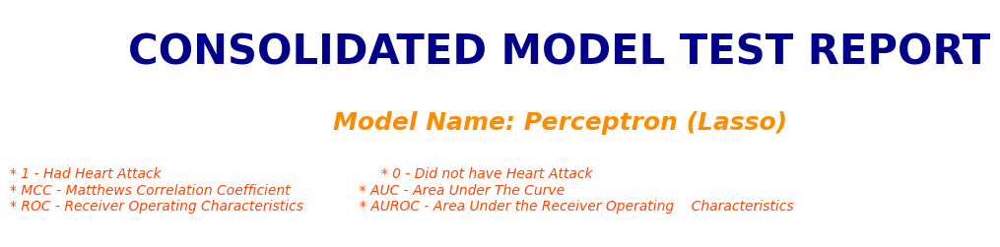

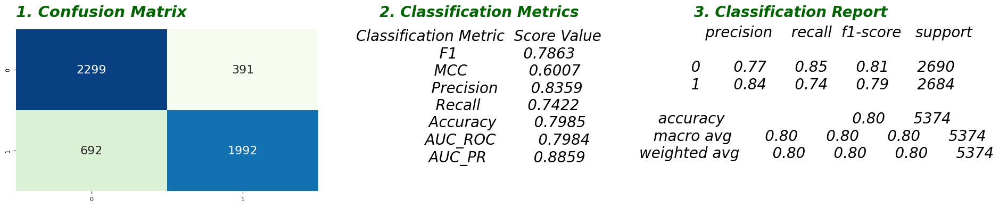

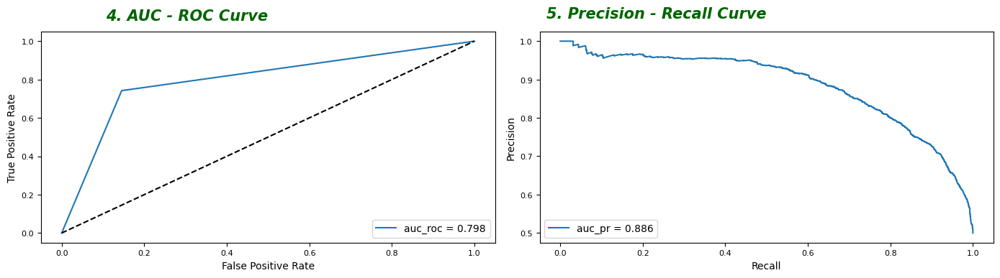

In [145]:
lasso_test_percep=Generate_Model_Test_Classification_Report(pModel, x_test_lasso, y_test_lasso, 'Perceptron (Lasso)')

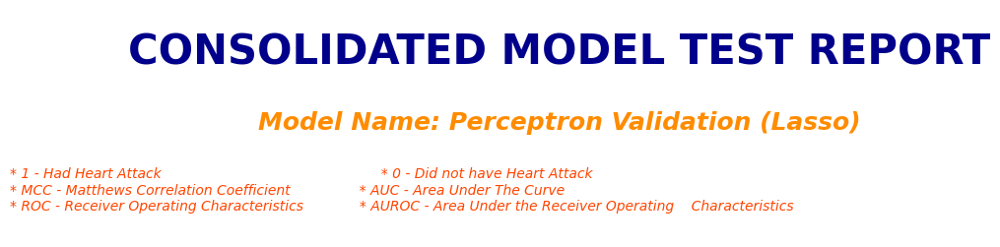

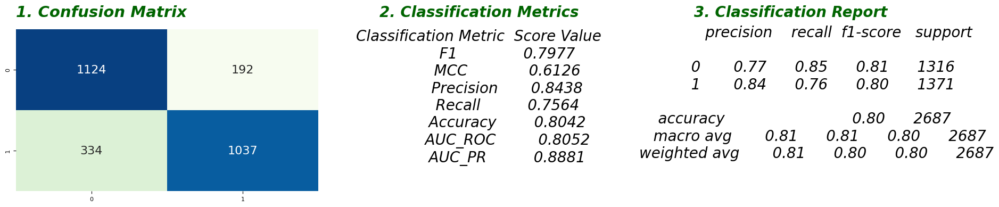

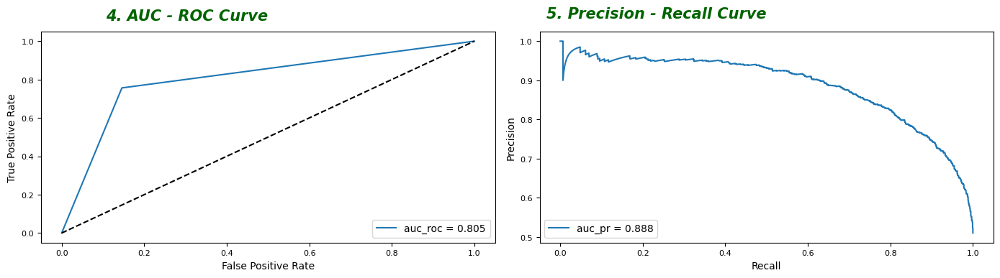

In [146]:
lasso_pm = Generate_Model_Test_Classification_Report(pModel, x_val_lasso, y_val_lasso, 'Perceptron Validation (Lasso)')

In [147]:
sgdModel=SGDClassifier(loss='log_loss')
sgdModel=sgdModel.fit(x_train_lasso, y_train_lasso)
sgdResults=sgdModel.predict(x_test_lasso)

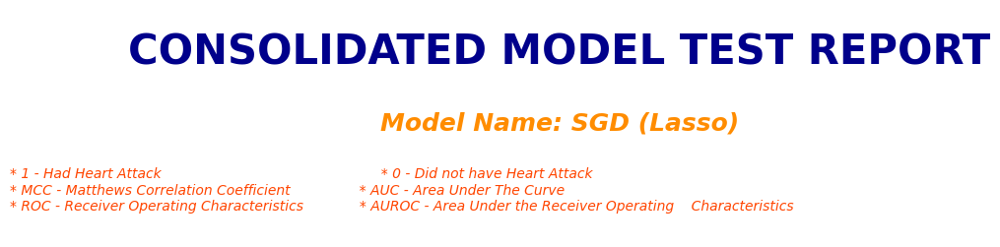

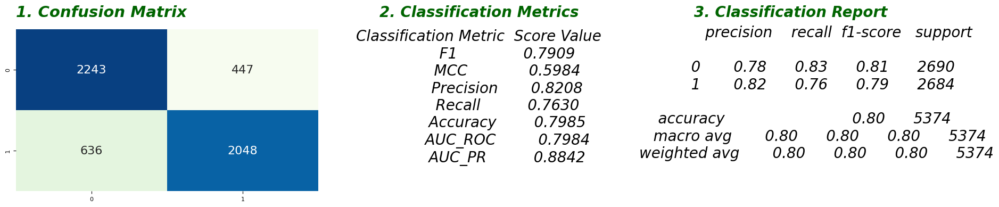

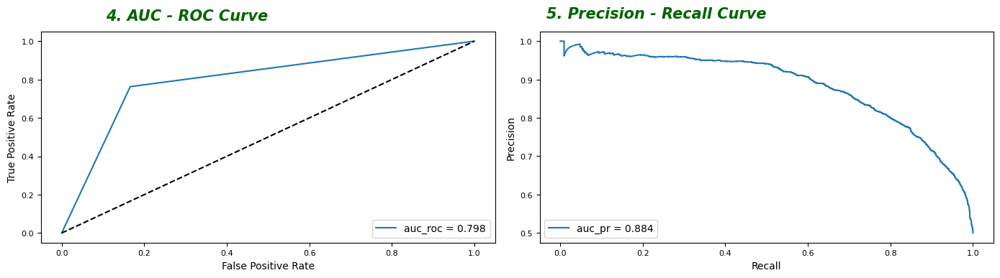

In [148]:
Lasso_test_sgd=Generate_Model_Test_Classification_Report(sgdModel, x_test_lasso, y_test_lasso, 'SGD (Lasso)')

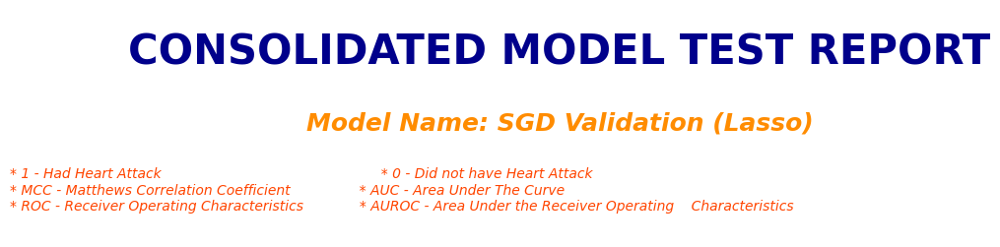

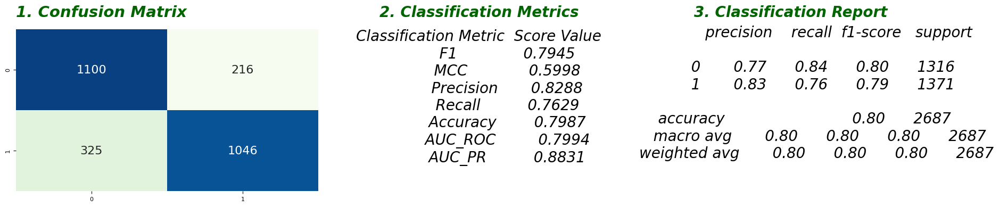

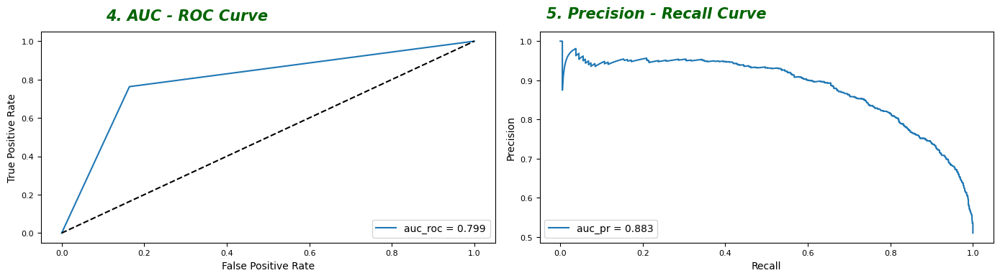

In [149]:
lasso_sgd = Generate_Model_Test_Classification_Report(sgdModel, x_val_lasso, y_val_lasso, 'SGD Validation (Lasso)')

In [150]:
lrModel=LogisticRegression(max_iter=300000)
lrModel=lrModel.fit(x_train_lasso, y_train_lasso)
lrResults=lrModel.predict(x_test_lasso)

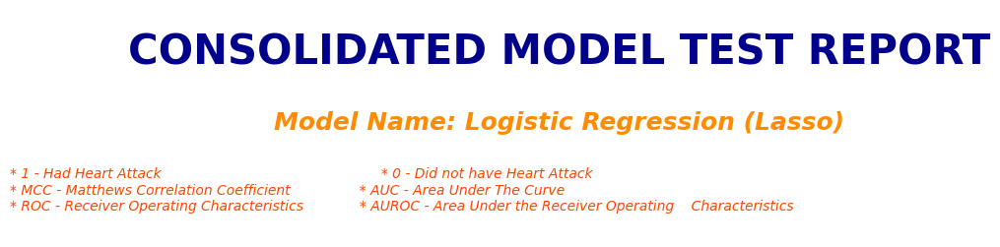

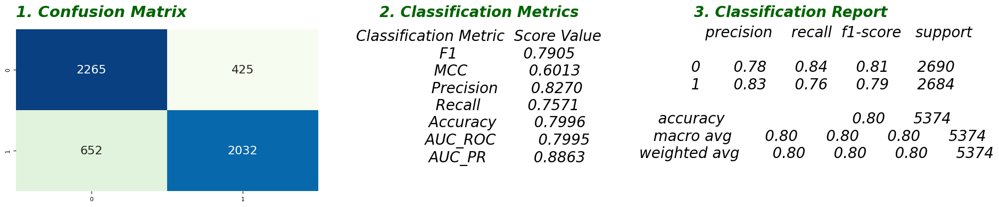

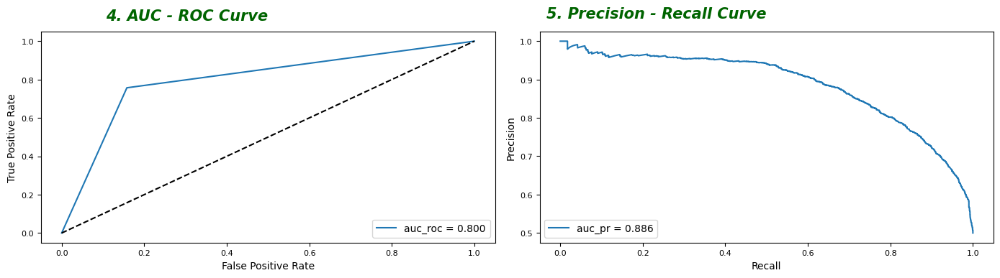

In [151]:
lasso_test_lr=Generate_Model_Test_Classification_Report(lrModel, x_test_lasso, y_test_lasso, 'Logistic Regression (Lasso)')

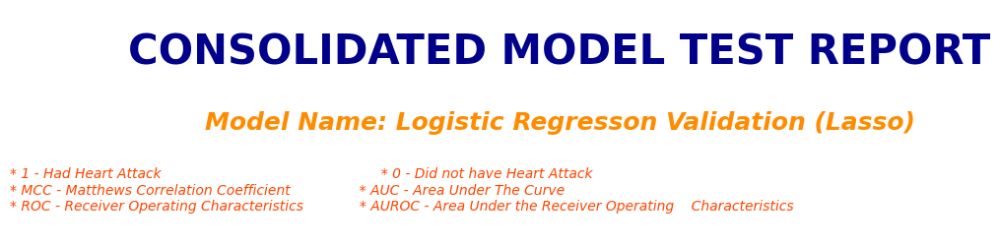

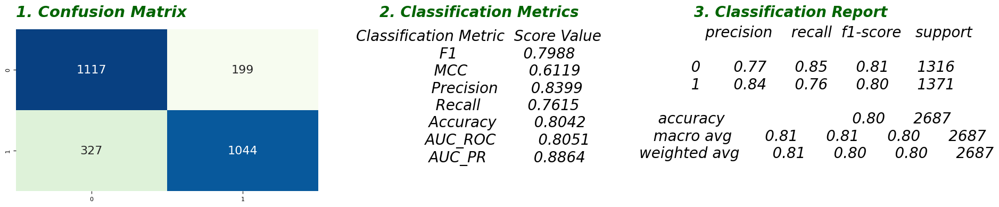

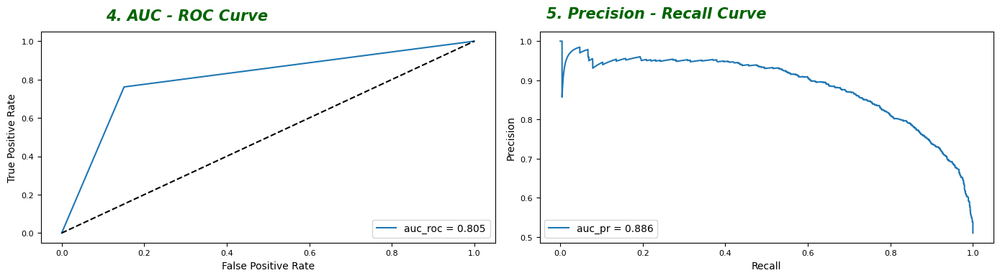

In [152]:
lasso_lr = Generate_Model_Test_Classification_Report(lrModel, x_val_lasso, y_val_lasso, 'Logistic Regresson Validation (Lasso)')

In [153]:
from sklearn.svm import LinearSVC

svmModel=CalibratedClassifierCV(LinearSVC(max_iter=50000))
svmModel=svmModel.fit(x_train_lasso, y_train_lasso)
svmResults=svmModel.predict(x_test_lasso)

The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.


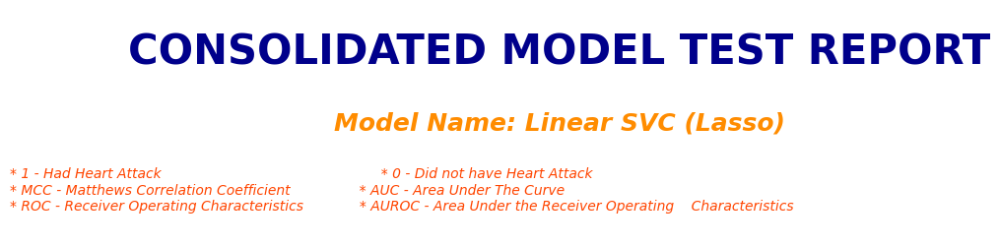

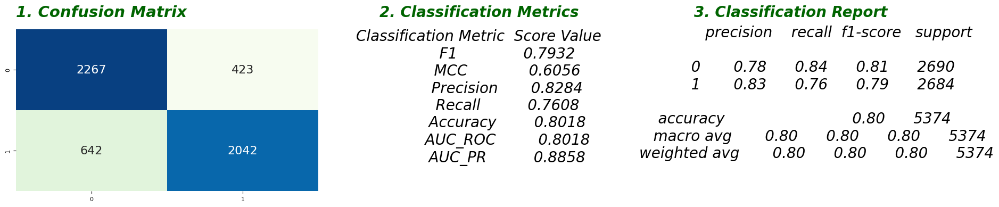

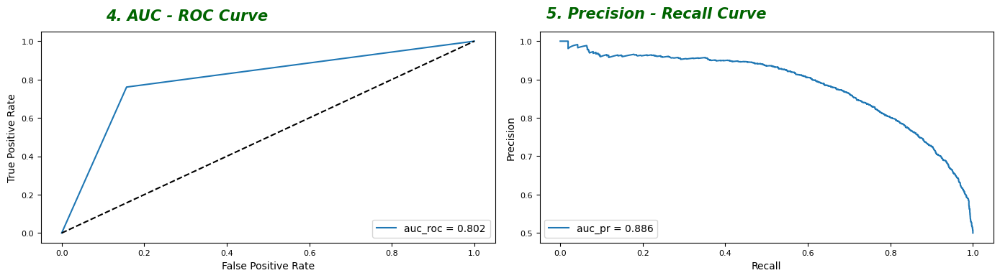

In [154]:
lasso_test_svm=Generate_Model_Test_Classification_Report(svmModel, X_test=x_test_lasso, y_test=y_test_lasso, model_name='Linear SVC (Lasso)')

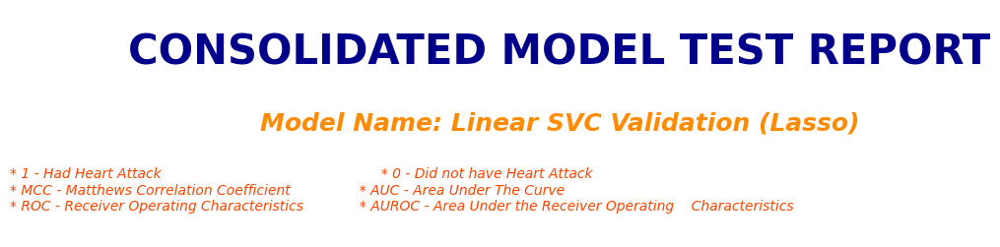

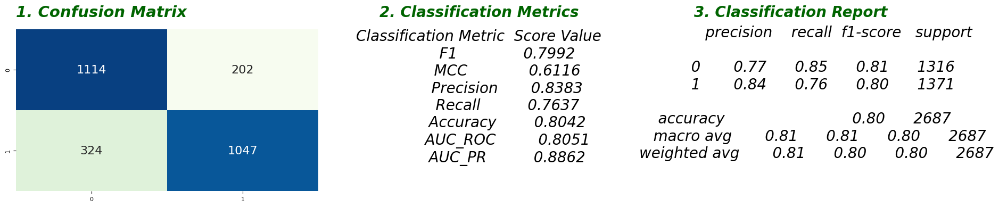

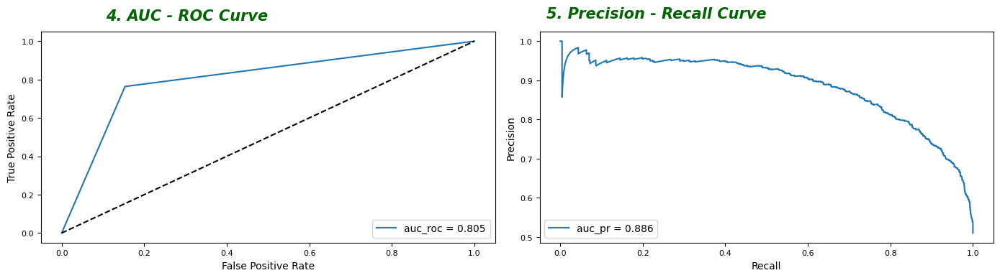

In [155]:
lasso_svm = Generate_Model_Test_Classification_Report(svmModel, x_val_lasso, y_val_lasso, 'Linear SVC Validation (Lasso)')

In [156]:
varb[featureIndx]

data[varb[featureIndx]]

,Sex,GeneralHealth,HadAngina,HadStroke,HadDiabetes,DifficultyWalking,SmokerStatus,ChestScan,AgeCategory,AlcoholDrinkers
57747,1,1,0,0,3,0,4,1,8,1
194270,2,3,0,0,3,0,4,0,4,0
134406,1,1,0,0,3,0,4,0,10,0
23565,1,3,1,0,3,0,4,1,5,1
79090,2,5,0,0,3,1,4,1,7,0
...,...,...,...,...,...,...,...,...,...,...
788,1,3,0,0,3,0,2,1,11,1
9513,1,4,0,0,3,1,4,1,13,1
105895,1,4,1,0,1,1,1,1,10,0
42268,2,4,1,0,3,0,1,1,9,0


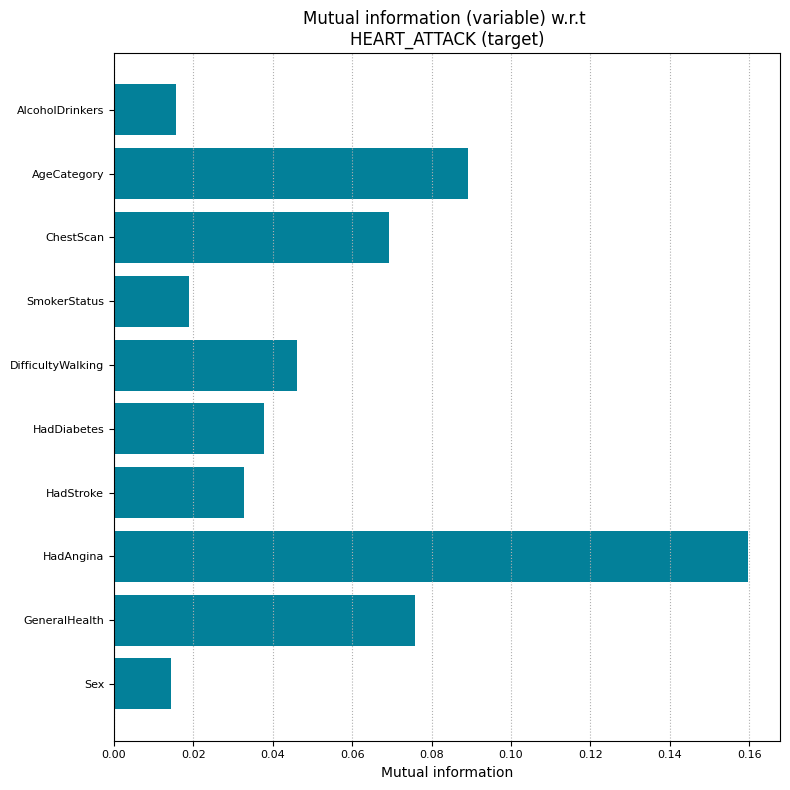

In [157]:
from sklearn.feature_selection import mutual_info_classif
opLabel = np.array(data['HadHeartAttack']).astype('int')
lasso_data = x_train_lasso
MI_features = lasso_data.columns 
mutual_infos = (mutual_info_classif(X=data[varb[featureIndx]],
                                    y=opLabel, 
                                    n_neighbors=10,
                                    random_state=20))
plt.figure(figsize=(8, 8))
plt.barh(y=MI_features, width=mutual_infos, color="#038099")
plt.title("Mutual information (variable) w.r.t \nHEART_ATTACK (target)");
plt.xlabel("Mutual information")
plt.gca().xaxis.grid(True, linestyle=':');
plt.tight_layout();

## Test Tables

In [158]:
results_tanova=[anova_test_percep[0],
         anova_test_sgd[0],
         anova_test_lr[0],
         anova_test_svm[0],]
models = ['Perceptron','SGD Tree','Logistic Regression','Linear SVC Validation']
results_tanova = pd.DataFrame(data = results_tanova)
results_tanova.columns = ['F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']
results_tanova['Models'] = models
results_tanova = results_tanova[['Models','F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']]
results_tanova

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.763110,0.567188,0.828173,0.707526,0.780610,0.780529,0.877781
1,SGD Tree,0.761786,0.588479,0.865403,0.680328,0.787495,0.787376,0.880946
2,Logistic Regression,0.787630,0.598950,0.829691,0.749627,0.798102,0.798048,0.882592
3,Linear SVC Validation,0.786412,0.595313,0.826087,0.750373,0.796427,0.796376,0.882301


In [159]:
results_tchisq=[chisq_test_percep[0],
         chisq_test_sgd[0],
         chisq_test_lr[0],
         chisq_test_svm[0],]
models = ['Perceptron','SGD Tree','Logistic Regression','Linear SVC Validation']
results_tchisq = pd.DataFrame(data = results_tchisq)
results_tchisq.columns = ['F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']
results_tchisq['Models'] = models
results_tchisq = results_tchisq[['Models','F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']]
results_tchisq

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.770914,0.586607,0.844652,0.709016,0.789542,0.789452,0.882861
1,SGD Tree,0.768055,0.548852,0.788235,0.748882,0.774098,0.774069,0.849836
2,Logistic Regression,0.784245,0.593096,0.827201,0.745529,0.795125,0.795069,0.883037
3,Linear SVC Validation,0.783274,0.592173,0.827801,0.743294,0.794566,0.794509,0.882895


In [160]:
results_tlasso=[lasso_test_percep[0],
         Lasso_test_sgd[0],
         lasso_test_lr[0],
         lasso_test_svm[0],]
models = ['Perceptron','SGD Tree','Logistic Regression','Linear SVC Validation']
results_tlasso = pd.DataFrame(data = results_tlasso)
results_tlasso.columns = ['F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']
results_tlasso['Models'] = models
results_tlasso = results_tlasso[['Models','F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']]
results_tlasso

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.786264,0.600679,0.835921,0.742176,0.798474,0.798411,0.885907
1,SGD Tree,0.790886,0.598398,0.820842,0.763040,0.798474,0.798435,0.884172
2,Logistic Regression,0.790508,0.601293,0.827025,0.757079,0.799591,0.799543,0.886289
3,Linear SVC Validation,0.793164,0.605626,0.828398,0.760805,0.801824,0.801778,0.885775


## Validation Tables

In [161]:
results_lasso=[lasso_pm[0],
         lasso_sgd[0],
         lasso_lr[0],
         lasso_svm[0],]
models = ['Perceptron','SGD Tree','Logistic Regression','Linear SVC Validation']
results_lasso = pd.DataFrame(data = results_lasso)
results_lasso.columns = ['F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']
results_lasso['Models'] = models
results_lasso = results_lasso[['Models','F1','MCC','Precision','Recall','Accuracy','AUC_ROC','AUC_PR']]
results_lasso


,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.797692,0.612586,0.843775,0.756382,0.804243,0.805243,0.888122
1,SGD Tree,0.794531,0.599792,0.828843,0.762947,0.798660,0.799407,0.883075
2,Logistic Regression,0.798776,0.611859,0.839903,0.761488,0.804243,0.805136,0.886364
3,Linear SVC Validation,0.799237,0.611568,0.838271,0.763676,0.804243,0.805090,0.886179


In [162]:
results_chisq

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.782163,0.597423,0.852107,0.722830,0.794566,0.796065,0.882123
1,SGD Tree,0.767442,0.539723,0.789961,0.746171,0.769259,0.769742,0.861592
2,Logistic Regression,0.787152,0.595550,0.838417,0.741794,0.795311,0.796429,0.883745
3,Linear SVC Validation,0.787785,0.596123,0.837993,0.743253,0.795683,0.796779,0.883108


In [163]:
results_anova

,Models,F1,MCC,Precision,Recall,Accuracy,AUC_ROC,AUC_PR
0,Perceptron,0.765101,0.565191,0.833907,0.706783,0.778563,0.780063,0.876229
1,SGD Tree,0.755119,0.571032,0.860878,0.672502,0.777447,0.779640,0.877851
2,Logistic Regression,0.783282,0.588070,0.834295,0.738147,0.791589,0.792706,0.880787
3,Linear SVC Validation,0.780488,0.582892,0.831683,0.735230,0.788984,0.790107,0.880496
